<a href="https://colab.research.google.com/github/sarahfoudaa/housePrices/blob/main/XOrithm_task1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#library imports

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

from scipy.stats import skew, norm
from sklearn.model_selection import train_test_split
import scipy.stats as stats
import pylab
import warnings
warnings.filterwarnings('ignore')
from sklearn import preprocessing

from math import ceil
from itertools import zip_longest

In [ ]:
%cd /content/drive/MyDrive/machine_learning_projects/XOrthim

/content/drive/MyDrive/machine_learning_projects/XOrthim


In [ ]:
%pwd

'/content/drive/MyDrive/machine_learning_projects/XOrthim'

In [ ]:
%ls

'Data Scientist THA v1.0.pdf'   Untitled1.ipynb       'XOrithm task2.ipynb'
 housing_data_900.csv           Untitled2.ipynb
 housing_data_900.gsheet       'XOrithm task1.ipynb'


# Functions

In [ ]:
def data_info(df):
  '''
  Function that prints some important informations about the raw dataset at the beginning of the EDA select_dtypes

  parameters:
    df(DataFrame):dataframe of the raw dataset
  '''
  #print('sample of the data \n', df.head(5),'\n')
  pd.set_option('display.max_columns', None)
  pd.set_option('display.max_rows', None)
  print('data types \n', df.info(),'\n \n')
  print('data describtion \n', df.describe().T,'\n \n')

  num_features = df.select_dtypes("number").columns
  print('numeric columns \n', num_features ,'\n \n')
  print('unique values for numeric features \n', df[num_features].nunique(),'\n \n')

  obj_features = df.select_dtypes(include= object).columns
  print('object columns \n', obj_features,'\n \n')
  print('unique values for object features \n', df[obj_features].nunique(),'\n \n')


  #print('unique values for each feature \n', df.nunique(),'\n \n')
  print('sum of missing values \n',df.isna().sum(),'\n \n')
  print('percentage of missing values \n', df.isna().mean(),'\n \n')
  #print('skewness of numerical data', df.skew())
  sns.heatmap(df.isna(), cbar = False, cmap = 'viridis')

In [ ]:
def vis(df,feature):
  '''
  Function that visualize the histplot, boxplot, and violinplot for a specific feature in the dataset to give insight on the distribution, the IQR, and if there is any outliers

  parameters:
    df(DataFrame):dataframe of the dataset
    feature(string): a column in the sent received dataset
  '''
  sns.set()
  plt.figure(figsize = (7,5))
  fig, axes = plt.subplots(2, 2,figsize = (15,8))
  sns.histplot(x = df[feature],ax=axes[0,0],kde = True,stat = 'density')
  sns.boxplot(data = df, x= feature,ax=axes[0,1])
  sns.violinplot(x = df[feature],ax=axes[1,0])


In [ ]:
def detect_outliers_iqr(df,features):
  '''
  Function that calculates the lower and upper bounf of a nuerical feature to then get the outliers that are not within these bounds and prints these outliers values

  Parameters:
    df(DataFrame): dataframe of the dataset
    feature(list): A list of column names in the DataFrame to analyze.
  '''
  outliers = []
  before_lwr_bound= []
  after_upr_bound =[]
  for feature in features:
    df[feature] = sorted(df[feature])
    q1 = np.percentile(df[feature], 25)
    q3 = np.percentile(df[feature], 75)
    IQR = q3- q1
    lwr_bound = q1 - (1.5*IQR)
    upr_bound = q3 + (1.5*IQR)

    for i in df[feature]:
      if (i<lwr_bound):
        outliers.append(i)
        before_lwr_bound.append(i)
      if (i>upr_bound):
        outliers.append(i)
        after_upr_bound.append(i)
    print("\n \n -------------------", feature, "------------------- \n")
    print("Outliers of ",feature ," from IQR method: ", 'length: ',len(outliers) ," - ", set(outliers))
    print('before lower bound of ',feature ," : ",'length: ', len(before_lwr_bound) ," - ", set(before_lwr_bound))
    print('after upper bound of ',feature ," : ", 'length: ',len(after_upr_bound)," - ", set(after_upr_bound))
    sns.histplot(x=outliers)
    plt.xlabel(feature + ' (Outliers)')
    plt.ylabel('Frequency')
    plt.title('Histogram of Outliers in ' + feature)
    plt.show()




def detect_outliers_iqr_exclude_zeros(df, features):
  """
  Function that calculates IQR-based outliers, excluding zeros, and displays results and histograms.

  Parameters:
      df (pandas.DataFrame): The dataset containing the features.
      features (list): A list of column names in the DataFrame to analyze.
  """

  for feature in features:
    df_filtered = df[df[feature] != 0]

    q1 = np.percentile(df_filtered[feature], 25)
    q3 = np.percentile(df_filtered[feature], 75)
    IQR = q3 - q1

    lwr_bound = q1 - (1.5 * IQR) if q1 > 0 else 0
    upr_bound = q3 + (1.5 * IQR)

    outliers = []
    before_lwr_bound = []
    after_upr_bound = []

    for i in df_filtered[feature]:
      if (i < lwr_bound):
        outliers.append(i)
        before_lwr_bound.append(i)
      if (i > upr_bound):
        outliers.append(i)
        after_upr_bound.append(i)

    print("\n \n -------------------", feature, "------------------- \n")
    print("Outliers of", feature, "from IQR method: ", 'length:', len(outliers), " - ", set(outliers))
    print('before lower bound of', feature, ":", 'length:', len(before_lwr_bound), " - ", set(before_lwr_bound))
    print('after upper bound of', feature, ":", 'length:', len(after_upr_bound), " - ", set(after_upr_bound))

    if len(outliers) > 0:
      sns.histplot(x=outliers)
      plt.xlabel(feature + ' (Outliers)')
      plt.ylabel('Frequency')
      plt.title('Histogram of Outliers in zero excluded' + feature)
      plt.show()


In [ ]:
def detect_distriution(df, num_features):
  '''
  Function that detect the skewness from the normal distribution of the numerical features in the dataset and divid them into categories (highly_positively_skewed, highly_negatively_skewed, moderately_positively_skewed, moderately_negatively_skewed, and normally_distributed) which each of them have a range of skewness

  parameters:
    df(DataFrame):dataframe of the dataset

  Returns:
    non_normal_features(string): a string that contains all non uniform distributed features
  '''
  highly_positively_skewed = [x for x in num_features if dict(df.skew(numeric_only=True)>1)[x] == True]
  highly_negatively_skewed = [x for x in num_features if dict(df.skew(numeric_only=True)<-1)[x] == True]
  moderately_positively_skewed = [x for x in num_features if (dict(df.skew(numeric_only=True)>0.5 )[x] == True) and (dict(df.skew(numeric_only=True)<1 )[x] == True)]
  moderately_negatively_skewed = [x for x in num_features if (dict(df.skew(numeric_only=True)>-0.5 )[x] == True) and (dict(df.skew(numeric_only=True)<-1 )[x] == True)]
  normally_distributed = [x for x in num_features if (dict(df.skew(numeric_only=True)>-0.5 )[x] == True) and (dict(df.skew(numeric_only=True)<0.5 )[x] == True)]
  print()
  print('features that are highly positively skewed (skewness >1) are ',highly_positively_skewed)
  print('features that are highly negatively skewed (skewness <-1) are ',highly_negatively_skewed)
  print('features that are moderately positively skewed (0.5 < skewness < 1 ) are ',moderately_positively_skewed)
  print('features that are moderately negatively skewed (-0.5 < skewness < -1 ) are ',moderately_negatively_skewed)
  print('features that are normally distributed (-0.5 < skewness < 0.5 ) are',normally_distributed)
  print()

  for col in num_features:
    plt.subplot(1,2,1)
    sns.violinplot(df[col])
    plt.subplot(1,2,2)
    sns.histplot(df[col],kde = True,stat = 'density')
    plt.show()

  non_normal_features = highly_positively_skewed + highly_negatively_skewed + moderately_positively_skewed + moderately_negatively_skewed

  print('transformation ',non_normal_features,' to change the distribution')
  return non_normal_features



def detect_distribution_exclude_zeros(df, num_features):
  """
  Function that analyzes the skewness of numerical features (excluding zeros) and categorizes them based on skewness levels.

  Parameters:
      df (pandas.DataFrame): The dataset containing the features.
      num_features (list): A list of column names (numerical features) in the DataFrame to analyze.

  Returns:
      non_normal_features (list): A list of feature names that are not normally distributed.
  """

  highly_positively_skewed = []
  highly_negatively_skewed = []
  moderately_positively_skewed = []
  moderately_negatively_skewed = []
  normally_distributed = []

  for feature in num_features:
    df_filtered = df[df[feature] != 0]

    skewness = df_filtered[feature].skew()

    if skewness > 1:
      highly_positively_skewed.append(feature)
    elif skewness < -1:
      highly_negatively_skewed.append(feature)
    elif 0.5 < skewness < 1:
      moderately_positively_skewed.append(feature)
    elif -0.5 < skewness < -1:
      moderately_negatively_skewed.append(feature)
    else:
      normally_distributed.append(feature)

  print()
  print('Features that are highly positively skewed (skewness > 1) are:', highly_positively_skewed)
  print('Features that are highly negatively skewed (skewness <-1) are:', highly_negatively_skewed)
  print('Features that are moderately positively skewed (0.5 < skewness < 1) are:', moderately_positively_skewed)
  print('Features that are moderately negatively skewed (-0.5 < skewness < -1) are:', moderately_negatively_skewed)
  print('Features that are normally distributed (-0.5 < skewness < 0.5) are:', normally_distributed)
  print()

  for col in num_features:
    df_filtered = df[df[col] != 0]
    plt.subplot(1, 2, 1)
    sns.violinplot(df_filtered[col])
    plt.subplot(1, 2, 2)
    sns.histplot(df_filtered[col], kde=True, stat='density')
    plt.show()

  non_normal_features = highly_positively_skewed + highly_negatively_skewed + moderately_positively_skewed + moderately_negatively_skewed

  print('Features requiring transformation (not normally distributed):', non_normal_features)
  return non_normal_features


In [ ]:
def plot_kde_probplot(df,feature,title):
  '''
  Function that plots the kdeplot and subplot to them give us insight of which transformationis better for this feature from the plotting and the calculations of the mean and std

  parameters:
    df(DataFrame):dataframe of the dataset
    feature(string): a column in the sent received dataset
    title(string): a string that indicates what transformation are we applying for visualization
  '''
  plt.figure(figsize = (5,3))
  plt.subplot(1,2,1)
  sns.kdeplot(df[feature])
  plt.subplot(1,2,2)
  stats.probplot(df[feature], plot = pylab)
  print('mean = ',df[feature].mean(),' std = ',df[feature].std())
  plt.title(title)
  plt.show()

def normality(df, feature):#original, log, reciprocal, square root, and exponential
  '''
  Function that calls for the plot_kde_probplot function to plot different types of transformations( log, reciprocal, square root, and exponential) for a scpecific feature to give us insight which is the best according to the ploting and calculations displayed

  Parameters:
    df(DataFrame):dataframe of the dataset
    feature(string): a column in the sent received dataset
  '''
  #original
  plot_kde_probplot(df,feature,'original')
  print(df[feature].skew(),'\n')

  #log
  test = pd.DataFrame(np.log(df[feature].dropna()))
  plot_kde_probplot(test, feature,'log')
  print(test.skew(),'\n')

  #reciprocal
  test = pd.DataFrame(1/df[feature].dropna())
  plot_kde_probplot(test, feature,'reciprotical')
  print(test.skew(),'\n')

  #square root
  test = pd.DataFrame(np.sqrt(df[feature].dropna()))
  plot_kde_probplot(test, feature,'square root')
  print(test.skew(),'\n')

  #exponential
  test = pd.DataFrame(df[feature].dropna()**(1/1.2))
  plot_kde_probplot(test,feature,'exponential')
  print(test.skew(),'\n')



In [ ]:
def outliers_handeler(df,features):
  '''
  Function that handels outliers and put them in the range of the IQR

  parameters:
    df (pandas.DataFrame): The dataset containing the features.
      features (list): A list of column names (numerical features) in the DataFrame to analyze.
  '''
  for feature in features:
    tenth_percentile = np.percentile(df[feature],10)
    ninetieth_percentile = np.percentile(df[feature],90)
    b = np.where(df[feature]< tenth_percentile, tenth_percentile, df[feature])
    b = np.where(b>ninetieth_percentile, ninetieth_percentile, b)
    df[feature] = pd.DataFrame(b)


def outliers_handler_exclude_zeros(df, features):
  """
  Function that handles outliers in numerical features (excluding zeros) by capping them to the IQR range.

  Parameters:
      df (pandas.DataFrame): The dataset containing the features.
      features (list): A list of column names (numerical features) in the DataFrame to analyze.
  """

  for feature in features:
    # Filter non-zero values
    df_filtered = df[df[feature] != 0]

    # Calculate percentiles using filtered data
    tenth_percentile = np.percentile(df_filtered[feature], 5)
    ninetieth_percentile = np.percentile(df_filtered[feature], 95)

    # Cap outliers using filtered percentiles
    df.loc[df[feature] < tenth_percentile, feature] = tenth_percentile
    df.loc[df[feature] > ninetieth_percentile, feature] = ninetieth_percentile

  return df

In [ ]:
def plot_value_counts(df):
  string_data = df.select_dtypes(object)
  n_string_features = string_data.shape[1]
  nrows, ncols = ceil(n_string_features / 4), 4

  fig, axs = plt.subplots(ncols=ncols, nrows=nrows, figsize=(14, 80))

  for feature_name, ax in zip_longest(string_data, axs.ravel()):
      if feature_name is None:
          ax.axis("off")
          continue

      string_data[feature_name].value_counts().plot.barh(ax=ax)
      ax.set_title(feature_name)

  plt.subplots_adjust(hspace=0.2, wspace=0.8)

In [ ]:
def detect_box_voilin_hist(df,num_features):
  fig, axes = plt.subplots(len(num_features), 3, figsize=(30, len(num_features)*5))

  for i, feature in enumerate(num_features):
      box_ax = axes[i, 0]
      violin_ax = axes[i, 1]
      hist_ax = axes[i, 2]

      sns.boxplot(x=df[feature], ax=box_ax)
      box_ax.set_xlabel(feature)
      box_ax.set_title(f"{feature} - Boxplot", fontsize=20)

      sns.violinplot(x=df[feature], ax=violin_ax)
      violin_ax.set_xlabel(feature)
      violin_ax.set_title(f"{feature} - Violin Plot", fontsize=20)

      sns.histplot(df[feature], ax=hist_ax,kde = True,stat = 'density')
      hist_ax.set_xlabel(feature)
      hist_ax.set_title(f"{feature} - Histogram", fontsize=20)

  plt.tight_layout()

  plt.show()


def detect_box_voilin_hist_exclude_zeros(df, num_features):
  """
  Function that creates boxplots, violin plots, and histograms for numerical features, excluding zeros.

  Parameters:
      df (pandas.DataFrame): The dataset containing the features.
      num_features (list): A list of column names (numerical features) in the DataFrame to analyze.
  """

  fig, axes = plt.subplots(len(num_features), 3, figsize=(30, len(num_features)*5))  # Adjust figsize as needed

  for i, feature in enumerate(num_features):
    # Filter non-zero values
    df_filtered = df[df[feature] != 0]

    box_ax = axes[i, 0]
    violin_ax = axes[i, 1]
    hist_ax = axes[i, 2]

    sns.boxplot(x=df_filtered[feature], ax=box_ax)
    box_ax.set_xlabel(feature)
    box_ax.set_title(f"{feature} - Boxplot", fontsize=20)

    sns.violinplot(x=df_filtered[feature], ax=violin_ax)
    violin_ax.set_xlabel(feature)
    violin_ax.set_title(f"{feature} - Violin Plot", fontsize=20)

    sns.histplot(df_filtered[feature], ax=hist_ax, kde=True, stat='density')
    hist_ax.set_xlabel(feature)
    hist_ax.set_title(f"{feature} - Histogram", fontsize=20)

  plt.tight_layout()
  plt.show()

In [ ]:
def remove_duplicates(df):
  '''
  Function that removed duplicates

  parameters:
    df(dataframe)
  '''
  print('nuber of duplicats = ',df[df.duplicated()==True].shape[0])
  print('assumed numbers of rows remaining = ',df.shape[0] - df[df.duplicated()==True].shape[0])
  df.drop_duplicates(keep = 'first', inplace = True)
  df.reset_index(inplace = True,drop=True)
  print('number of rows after removing the duplicates = ',df.shape[0])

#data import

In [ ]:
pd.set_option('display.max_columns', None)
df = pd.read_csv('./housing_data_900.csv')
orignal = df.copy()
df.head(5)

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1001,527131110,120,RL,45.0,6264,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,5,1997,1997,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Gd,TA,PConc,Ex,TA,Mn,GLQ,656.0,Unf,0.0,1008.0,1664.0,GasA,Ex,Y,SBrkr,1682,0,0,1682,1.0,0.0,1,1,1,1,Gd,6,Min1,1,TA,Attchd,1997.0,Fin,2,528,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2008,WD,Normal,247900
1,1002,527140090,120,RL,41.0,5395,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1993,1993,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,733.0,Unf,0.0,604.0,1337.0,GasA,Gd,Y,SBrkr,1337,0,0,1337,1.0,0.0,2,0,2,1,Gd,5,Typ,1,TA,Attchd,1993.0,RFn,2,462,TA,TA,Y,96,0,70,168,0,0,NaN,NaN,NaN,0,10,2008,WD,Normal,180000
2,1003,527145090,120,RL,39.0,5070,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,1280.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2,506,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,8,2008,WD,Normal,180000
3,1004,527161010,60,RL,100.0,10839,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,926.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1997.0,Fin,2,470,TA,TA,Y,0,36,0,0,0,0,NaN,NaN,NaN,0,7,2008,WD,Normal,181000
4,1005,527162180,60,RL,73.0,11184,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,932.0,932.0,GasA,Gd,Y,SBrkr,932,701,0,1633,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1998.0,Fin,2,460,TA,TA,Y,0,39,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Family,183000


In [ ]:

continous_feat = ['Lot Frontage', 'Lot Area','Mas Vnr Area','BsmtFin SF 1','BsmtFin SF 2','Bsmt Unf SF','Total Bsmt SF','1st Flr SF','2nd Flr SF','Low Qual Fin SF', 'Gr Liv Area','Garage Area','Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch' , 'Pool Area', 'Misc Val']
disc_feat = ['Year Built', 'Year Remod/Add', 'Bsmt Full Bath','Bsmt Half Bath', 'Full Bath', 'Half Bath','Bedroom AbvGr', 'TotRms AbvGrd', 'Fireplaces', 'Garage Yr Blt', 'Garage Cars', 'Mo Sold', 'Yr Sold']
numerical_feat = continous_feat + disc_feat

ordinal_feat = ['Lot Shape', 'Utilities', 'Land Slope', 'Overall Qual', 'Overall Cond', 'Exter Qual', 'Exter Cond', 'Bsmt Qual', 'Kitchen Qual', 'Bsmt Cond', 'Bsmt Exposure', 'BsmtFin Type 1', 'BsmtFin Type 2', 'Heating QC', 'Electrical', 'Kitchen Qual', 'Functional', 'Fireplace Qu', 'Garage Finish', 'Garage Qual', 'Garage Cond', 'Paved Drive', 'Pool QC', 'Fence']
nominal_feat = ['MS SubClass', 'MS Zoning', 'Street', 'Alley', 'Land Contour', 'Lot Config', 'Neighborhood', 'Condition 1', 'Condition 2', 'Bldg Type', 'House Style', 'Roof Style', 'Roof Matl', 'Exterior 1st', 'Exterior 2nd', 'Mas Vnr Type', 'Foundation', 'Heating', 'Central Air', 'Garage Type', 'Misc Feature', 'Sale Type', 'Sale Condition']
cat_feat = ordinal_feat + nominal_feat

#EDA - data cleaning - visualization

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900 entries, 0 to 899
Data columns (total 82 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Order            900 non-null    int64  
 1   PID              900 non-null    int64  
 2   MS SubClass      900 non-null    int64  
 3   MS Zoning        900 non-null    object 
 4   Lot Frontage     734 non-null    float64
 5   Lot Area         900 non-null    int64  
 6   Street           900 non-null    object 
 7   Alley            65 non-null     object 
 8   Lot Shape        900 non-null    object 
 9   Land Contour     900 non-null    object 
 10  Utilities        900 non-null    object 
 11  Lot Config       900 non-null    object 
 12  Land Slope       900 non-null    object 
 13  Neighborhood     900 non-null    object 
 14  Condition 1      900 non-null    object 
 15  Condition 2      900 non-null    object 
 16  Bldg Type        900 non-null    object 
 17  House Style     

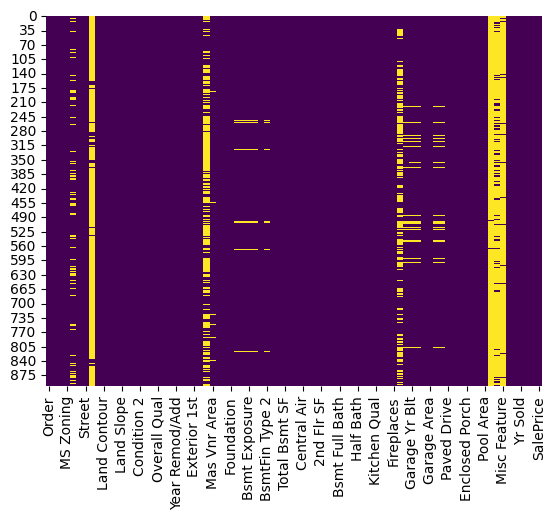

In [ ]:
num_features, obj_features = data_info(df)

In [ ]:
df['Neighborhood'].unique()

array(['StoneBr', 'Gilbert', 'NWAmes', 'NAmes', 'BrDale', 'NPkVill',
       'NridgHt', 'Blmngtn', 'NoRidge', 'Somerst', 'SawyerW', 'Sawyer',
       'Veenker', 'BrkSide', 'OldTown', 'IDOTRR', 'ClearCr', 'Edwards',
       'CollgCr', 'SWISU', 'Crawfor', 'Blueste', 'Mitchel', 'Timber',
       'MeadowV', 'Greens'], dtype=object)

In [ ]:
df['Year Built'].unique()

array([1997, 1993, 1992, 1998, 1995, 1994, 1991, 1988, 1989, 2005, 2004,
       1952, 2007, 1950, 1986, 1981, 1983, 1978, 1979, 1977, 1976, 1980,
       1969, 1973, 1996, 1974, 1971, 1972, 1970, 1975, 1966, 2008, 2006,
       2003, 2001, 2002, 2000, 1999, 1963, 1962, 1961, 1968, 1990, 1984,
       1967, 1965, 1956, 1957, 1964, 1959, 1960, 1949, 1935, 1939, 1937,
       1955, 1953, 1958, 1951, 1947, 1948, 1925, 1945, 1940, 1922, 1900,
       1954, 1904, 1910, 1920, 1915, 1890, 1946, 1880, 1916, 1917, 1905,
       1928, 1914, 1872, 1926, 1893, 1930, 1924, 1941, 1929, 1923, 1931,
       1927, 1918, 1938, 1912, 1906, 1908, 1921, 1911, 1936, 1934, 1895,
       1982])

In [ ]:
df['MS SubClass'].unique()

array(['RL', 'RH', 'RM', 'FV', 'A (agr)', 'C (all)', 'I (all)'],
      dtype=object)

In [ ]:
for col in obj_features:
  print(col, ' : ',df[col].unique())

MS Zoning  :  ['RL' 'RH' 'RM' 'FV' 'A (agr)' 'C (all)' 'I (all)']
Street  :  ['Pave' 'Grvl']
Alley  :  [nan 'Pave' 'Grvl']
Lot Shape  :  ['IR1' 'Reg' 'IR3' 'IR2']
Land Contour  :  ['Lvl' 'HLS' 'Bnk' 'Low']
Utilities  :  ['AllPub' 'NoSewr']
Lot Config  :  ['Corner' 'Inside' 'FR3' 'CulDSac' 'FR2']
Land Slope  :  ['Gtl' 'Mod' 'Sev']
Neighborhood  :  ['StoneBr' 'Gilbert' 'NWAmes' 'NAmes' 'BrDale' 'NPkVill' 'NridgHt'
 'Blmngtn' 'NoRidge' 'Somerst' 'SawyerW' 'Sawyer' 'Veenker' 'BrkSide'
 'OldTown' 'IDOTRR' 'ClearCr' 'Edwards' 'CollgCr' 'SWISU' 'Crawfor'
 'Blueste' 'Mitchel' 'Timber' 'MeadowV' 'Greens']
Condition 1  :  ['Norm' 'Feedr' 'PosN' 'RRAn' 'RRAe' 'RRNe' 'Artery' 'PosA' 'RRNn']
Condition 2  :  ['Norm' 'PosN' 'Artery' 'Feedr' 'PosA' 'RRNn' 'RRAe' 'RRAn']
Bldg Type  :  ['1Fam' 'TwnhsE' 'Duplex' 'Twnhs' '2fmCon']
House Style  :  ['1Story' '2Story' 'SLvl' '2.5Unf' '1.5Fin' 'SFoyer' '1.5Unf' '2.5Fin']
Roof Style  :  ['Gable' 'Hip' 'Mansard' 'Gambrel' 'Flat' 'Shed']
Roof Matl  :  ['CompShg'

In [ ]:
nan = pd.DataFrame(df.isna().sum(), columns = ['NaN_sum'])
nan['feat'] = nan.index
nan['Perc(%)'] = (nan['NaN_sum']/1460)*100
nan = nan[nan['NaN_sum'] > 0]
nan = nan.sort_values(by = ['NaN_sum'])
nan['Usability'] = np.where(nan['Perc(%)'] > 20, 'Discard', 'Keep')
nan

,NaN_sum,feat,Perc(%),Usability
Total Bsmt SF,1,Total Bsmt SF,0.068493,Keep
Electrical,1,Electrical,0.068493,Keep
Bsmt Unf SF,1,Bsmt Unf SF,0.068493,Keep
BsmtFin SF 2,1,BsmtFin SF 2,0.068493,Keep
BsmtFin SF 1,1,BsmtFin SF 1,0.068493,Keep
Bsmt Full Bath,2,Bsmt Full Bath,0.136986,Keep
Bsmt Half Bath,2,Bsmt Half Bath,0.136986,Keep
Mas Vnr Area,12,Mas Vnr Area,0.821918,Keep
Bsmt Cond,21,Bsmt Cond,1.438356,Keep
BsmtFin Type 1,21,BsmtFin Type 1,1.438356,Keep


In [ ]:
len(df[df['Pool Area']==0])

896

In [ ]:
df['Pool QC'].isna().sum()

896

In [ ]:
df['Pool QC'].unique()

array([nan, 'Ex', 'Gd'], dtype=object)

In [ ]:
df[df['Pool Area']==0]['Pool QC'].unique()

array([nan], dtype=object)

since the number of entities with pool area = 0 (there is no pool) is eualto the number of missing values in the pool QC then this ins not missing values this is just means that there is no pool so there is no pool QC --> solution : make new category that indicates that there is no pool in this house

In [ ]:
df['Misc Feature'].unique()


array([nan, 'Shed', 'Othr', 'Gar2'], dtype=object)

In [ ]:
df[df['Misc Feature'].isna()]

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1001,527131110,120,RL,45.0,6264,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,5,1997,1997,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Gd,TA,PConc,Ex,TA,Mn,GLQ,656.0,Unf,0.0,1008.0,1664.0,GasA,Ex,Y,SBrkr,1682,0,0,1682,1.0,0.0,1,1,1,1,Gd,6,Min1,1,TA,Attchd,1997.0,Fin,2,528,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2008,WD,Normal,247900
1,1002,527140090,120,RL,41.0,5395,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1993,1993,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,733.0,Unf,0.0,604.0,1337.0,GasA,Gd,Y,SBrkr,1337,0,0,1337,1.0,0.0,2,0,2,1,Gd,5,Typ,1,TA,Attchd,1993.0,RFn,2,462,TA,TA,Y,96,0,70,168,0,0,NaN,NaN,NaN,0,10,2008,WD,Normal,180000
2,1003,527145090,120,RL,39.0,5070,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,1280.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2,506,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,8,2008,WD,Normal,180000
3,1004,527161010,60,RL,100.0,10839,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,926.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1997.0,Fin,2,470,TA,TA,Y,0,36,0,0,0,0,NaN,NaN,NaN,0,7,2008,WD,Normal,181000
4,1005,527162180,60,RL,73.0,11184,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,932.0,932.0,GasA,Gd,Y,SBrkr,932,701,0,1633,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1998.0,Fin,2,460,TA,TA,Y,0,39,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Family,183000
5,1006,527163100,60,RL,NaN,8000,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1995,1996,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,TA,TA,PConc,Gd,TA,No,GLQ,219.0,Unf,0.0,554.0,773.0,GasA,Gd,Y,SBrkr,773,885,0,1658,1.0,0.0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1995.0,Fin,2,431,TA,TA,Y,224,84,0,0,0,0,NaN,NaN,NaN,0,6,2008,WD,Normal,188000
7,1008,527165010,60,RL,NaN,14067,Pave,NaN,Reg,Lvl,AllPub,FR3,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1991,1991,Gable,CompShg,HdBoard,HdBoard,BrkFace,194.0,TA,TA,PConc,Gd,TA,No,ALQ,504.0,Unf,0.0,332.0,836.0,GasA,Gd,Y,SBrkr,851,858,0,1709,1.0,0.0,2,1,3,1,Gd,7,Typ,0,NaN,Attchd,1991.0,Fin,2,416,TA,TA,Y,0,40,0,0,0,0,NaN,GdPrv,NaN,0,9,2008,WD,Normal,185000
8,1009,527183030,120,RL,40.0,4671,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1988,1989,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,767.0,Unf,0.0,461.0,1228.0,GasA,Gd,Y,SBrkr,1228,0,0,1228,1.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,1988.0,Fin,2,472,TA,TA,Y,168,120,0,0,0,0,NaN,NaN,NaN,0,10,2008,WD,Normal,189000
9,1010,527183060,120,RL,65.0,5950,Pave,NaN,IR1,HLS,AllPub,Inside,Mod,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1989,1989,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,Gd,GLQ,319.0,Unf,0.0,1018.0,1337.0,GasA,Gd,Y,SBrkr,1337,0,0,1337,1.0,0.0,2,0,2,1,Gd,5,Typ,1

In [ ]:
numerical_data = df.select_dtypes("number")
numerical_data.hist(
    bins=20, figsize=(12, 22), edgecolor="black", layout=(9, 4)
)
plt.subplots_adjust(hspace=0.8, wspace=0.8)

ValueError: Layout of 9x4 must be larger than required size 39

<Figure size 1200x2200 with 0 Axes>

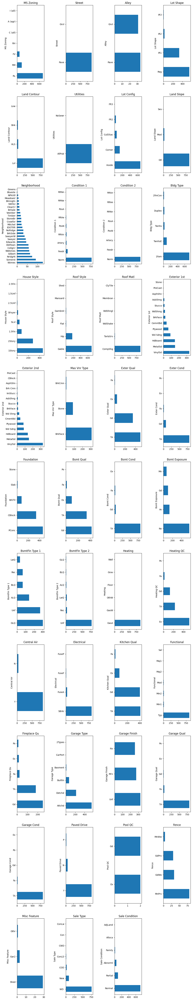

In [ ]:
plot_value_counts(df)

In [ ]:
df['Mas Vnr Type'].isna().sum()

497

In [ ]:
df[df['Mas Vnr Area'].isna()][['Mas Vnr Area','Mas Vnr Type' ]]

In [ ]:
df[df['Garage Yr Blt'].isna()][['Garage Type','Garage Yr Blt' ]]

,Garage Type,Garage Yr Blt
131,No Garage,NaN
134,No Garage,NaN
220,No Garage,NaN
259,No Garage,NaN
277,No Garage,NaN
291,No Garage,NaN
295,No Garage,NaN
298,No Garage,NaN
305,No Garage,NaN
314,No Garage,NaN


In [ ]:
df['Mas Vnr Area'].unique()

array([0.000e+00, 1.940e+02, 1.300e+02, 2.450e+02, 2.960e+02, 1.780e+02,
       4.400e+01, 1.230e+02, 1.020e+02, 2.100e+02, 1.740e+02, 3.830e+02,
       4.240e+02, 6.210e+02, 2.800e+02, 1.680e+02, 1.600e+02, 1.200e+02,
       6.600e+02, 4.020e+02, 7.200e+01, 3.590e+02, 1.580e+02, 4.220e+02,
       1.270e+02, 2.320e+02, 6.040e+02, 3.560e+02, 6.500e+01, 4.260e+02,
       2.720e+02, 8.160e+02, 2.680e+02, 3.020e+02, 4.360e+02, 5.540e+02,
       4.800e+02, 2.700e+02, 4.680e+02, 3.680e+02, 1.080e+02, 1.260e+02,
       6.800e+02, 6.640e+02, 2.920e+02, 5.040e+02, 1.110e+03, 2.210e+02,
       4.920e+02, 7.660e+02, 1.440e+02, 4.720e+02, 6.160e+02, 7.140e+02,
       1.760e+02, 1.960e+02, 1.060e+02, 1.460e+02, 1.430e+02, 2.400e+01,
       1.400e+01, 1.600e+01, 2.000e+01, 1.820e+02, 3.180e+02, 6.470e+02,
             nan, 1.290e+03, 4.730e+02, 3.500e+02, 2.950e+02, 4.950e+02,
       4.660e+02, 6.510e+02, 3.200e+02, 4.480e+02, 1.860e+02, 7.400e+01,
       5.300e+01, 1.280e+02, 2.840e+02, 2.560e+02, 

In [ ]:
df['Mas Vnr Type'].unique()

array([nan, 'BrkFace', 'Stone', 'BrkCmn'], dtype=object)

In [ ]:

df['Bsmt Full Bath'].unique()

array([ 1.,  0.,  2., nan])

In [ ]:
df[df['Lot Frontage']==0]

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice


In [ ]:
df[df['BsmtFin Type 2'].isna()][['BsmtFin Type 1','BsmtFin SF 1','BsmtFin Type 2',	'BsmtFin SF 2',	'Bsmt Unf SF',	'Total Bsmt SF']]

,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF
204,No Basement,0.0,NaN,0.0,0.0,0.0
219,No Basement,0.0,NaN,0.0,0.0,0.0
251,No Basement,0.0,NaN,0.0,0.0,0.0
254,No Basement,0.0,NaN,0.0,0.0,0.0
259,No Basement,0.0,NaN,0.0,0.0,0.0
268,No Basement,0.0,NaN,0.0,0.0,0.0
325,No Basement,0.0,NaN,0.0,0.0,0.0
341,No Basement,NaN,NaN,NaN,NaN,NaN
343,No Basement,0.0,NaN,0.0,0.0,0.0
374,No Basement,0.0,NaN,0.0,0.0,0.0


most of the missing values they are not missing by mistake but on pupose are they indicates that this feature is not presented in this entity

In [ ]:
#filling mistake nan values
values = {"Alley": 'No alley access',
          "Mas Vnr Type": 'no mas vnr',
          "Bsmt Qual": 'No Basement',
          "Bsmt Cond": 'No Basement',
          "Bsmt Exposure": 'No Basement',
          "BsmtFin Type 1": 'No Basement',
          "BsmtFin Type 2": 'No Basement',
          "Fireplace Qu": 'No Fireplace',
          "Garage Type": 'No Garage',
          "Garage Finish": 'No Garage',
          "Garage Qual": 'No Garage',
          "Garage Cond": 'No Garage',
          "Pool QC": 'No Pool',
          "Fence": 'No Fence',
          "Misc Feature": 'No Misc Feature',
          'Lot Frontage':0,
          'Mas Vnr Area':0,
          'BsmtFin SF 1':0,
          'BsmtFin SF 2':0,
          'Bsmt Unf SF':0,
          'Total Bsmt SF':0,
          'Garage Yr Blt':0}
df.fillna(value=values, inplace = True)
df.fillna(0, inplace = True)
df.drop(columns = ['Order','PID'], inplace = True)

In [ ]:
df.isna().sum()

MS SubClass        0
MS Zoning          0
Lot Frontage       0
Lot Area           0
Street             0
Alley              0
Lot Shape          0
Land Contour       0
Utilities          0
Lot Config         0
Land Slope         0
Neighborhood       0
Condition 1        0
Condition 2        0
Bldg Type          0
House Style        0
Overall Qual       0
Overall Cond       0
Year Built         0
Year Remod/Add     0
Roof Style         0
Roof Matl          0
Exterior 1st       0
Exterior 2nd       0
Mas Vnr Type       0
Mas Vnr Area       0
Exter Qual         0
Exter Cond         0
Foundation         0
Bsmt Qual          0
Bsmt Cond          0
Bsmt Exposure      0
BsmtFin Type 1     0
BsmtFin SF 1       0
BsmtFin Type 2     0
BsmtFin SF 2       0
Bsmt Unf SF        0
Total Bsmt SF      0
Heating            0
Heating QC         0
Central Air        0
Electrical         0
1st Flr SF         0
2nd Flr SF         0
Low Qual Fin SF    0
Gr Liv Area        0
Bsmt Full Bath     0
Bsmt Half Bat

In [ ]:
df.columns

Index(['MS SubClass', 'MS Zoning', 'Lot Frontage', 'Lot Area', 'Street',
       'Alley', 'Lot Shape', 'Land Contour', 'Utilities', 'Lot Config',
       'Land Slope', 'Neighborhood', 'Condition 1', 'Condition 2', 'Bldg Type',
       'House Style', 'Overall Qual', 'Overall Cond', 'Year Built',
       'Year Remod/Add', 'Roof Style', 'Roof Matl', 'Exterior 1st',
       'Exterior 2nd', 'Mas Vnr Type', 'Mas Vnr Area', 'Exter Qual',
       'Exter Cond', 'Foundation', 'Bsmt Qual', 'Bsmt Cond', 'Bsmt Exposure',
       'BsmtFin Type 1', 'BsmtFin SF 1', 'BsmtFin Type 2', 'BsmtFin SF 2',
       'Bsmt Unf SF', 'Total Bsmt SF', 'Heating', 'Heating QC', 'Central Air',
       'Electrical', '1st Flr SF', '2nd Flr SF', 'Low Qual Fin SF',
       'Gr Liv Area', 'Bsmt Full Bath', 'Bsmt Half Bath', 'Full Bath',
       'Half Bath', 'Bedroom AbvGr', 'Kitchen AbvGr', 'Kitchen Qual',
       'TotRms AbvGrd', 'Functional', 'Fireplaces', 'Fireplace Qu',
       'Garage Type', 'Garage Yr Blt', 'Garage Finish', 'Gara

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900 entries, 0 to 899
Data columns (total 80 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   MS SubClass      900 non-null    int64  
 1   MS Zoning        900 non-null    object 
 2   Lot Frontage     900 non-null    float64
 3   Lot Area         900 non-null    int64  
 4   Street           900 non-null    object 
 5   Alley            900 non-null    object 
 6   Lot Shape        900 non-null    object 
 7   Land Contour     900 non-null    object 
 8   Utilities        900 non-null    object 
 9   Lot Config       900 non-null    object 
 10  Land Slope       900 non-null    object 
 11  Neighborhood     900 non-null    object 
 12  Condition 1      900 non-null    object 
 13  Condition 2      900 non-null    object 
 14  Bldg Type        900 non-null    object 
 15  House Style      900 non-null    object 
 16  Overall Qual     900 non-null    int64  
 17  Overall Cond    

(Index(['MS SubClass', 'Lot Frontage', 'Lot Area', 'Overall Qual',
        'Overall Cond', 'Year Built', 'Year Remod/Add', 'Mas Vnr Area',
        'BsmtFin SF 1', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF',
        '1st Flr SF', '2nd Flr SF', 'Low Qual Fin SF', 'Gr Liv Area',
        'Bsmt Full Bath', 'Bsmt Half Bath', 'Full Bath', 'Half Bath',
        'Bedroom AbvGr', 'Kitchen AbvGr', 'TotRms AbvGrd', 'Fireplaces',
        'Garage Yr Blt', 'Garage Cars', 'Garage Area', 'Wood Deck SF',
        'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch',
        'Pool Area', 'Misc Val', 'Mo Sold', 'Yr Sold', 'SalePrice'],
       dtype='object'),
 Index(['MS Zoning', 'Street', 'Alley', 'Lot Shape', 'Land Contour',
        'Utilities', 'Lot Config', 'Land Slope', 'Neighborhood', 'Condition 1',
        'Condition 2', 'Bldg Type', 'House Style', 'Roof Style', 'Roof Matl',
        'Exterior 1st', 'Exterior 2nd', 'Mas Vnr Type', 'Exter Qual',
        'Exter Cond', 'Foundation', 'Bsmt 

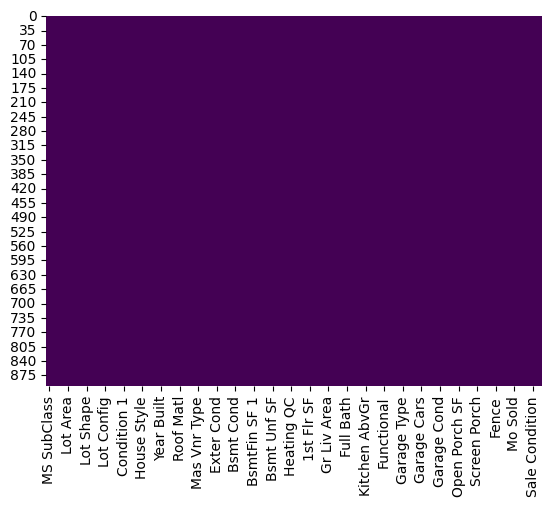

In [ ]:
data_info(df)

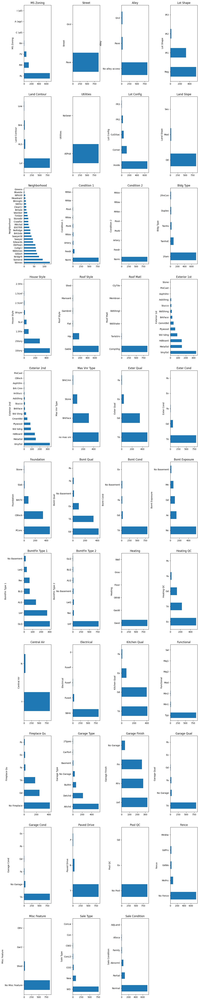

In [ ]:
plot_value_counts(df)

In [ ]:
remove_duplicates(df)

nuber of duplicats =  0
assumed numbers of rows remaining =  900
number of rows after removing the duplicates =  900


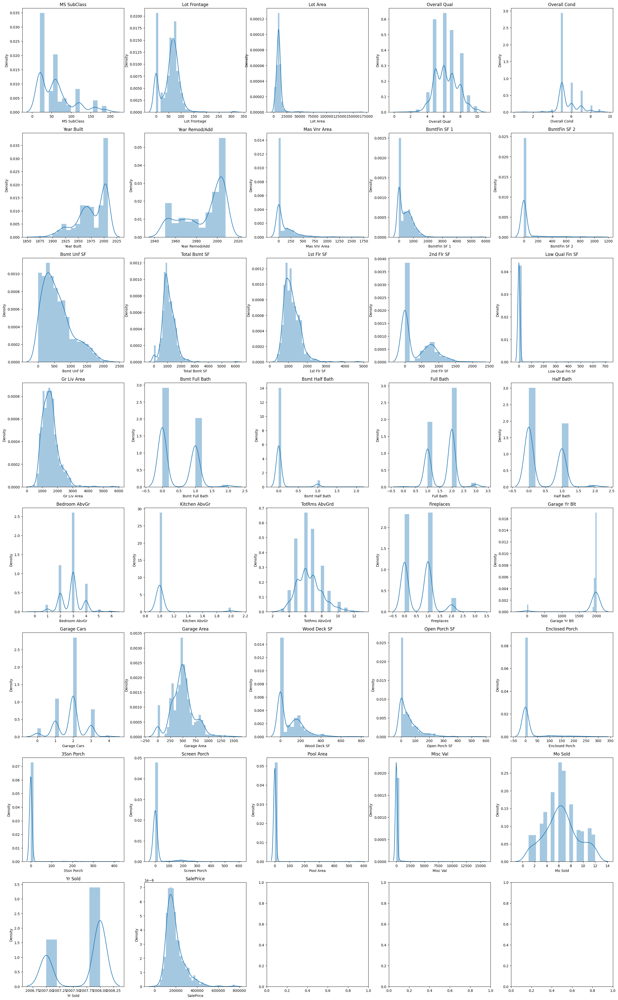

In [ ]:
newdf = df.select_dtypes("number")
fig, axes = plt.subplots(nrows = 8, ncols = 5)
axes = axes.flatten()
fig.set_size_inches(30, 50)

for ax, col in zip(axes, newdf.columns):
  sns.distplot(newdf[col], ax = ax)
  ax.set_title(col)

important features ['Kitchen Qual'

 'Garage Yr Blt',
 'Year Remod/Add',
 'Bsmt Qual',
 'Garage Area',
 'Year Built',
 'Lot Area',
 'Garage Cars',
 '2nd Flr SF',
 'BsmtFin SF 1',
 '1st Flr SF',
 'Total Bsmt SF',
 'Gr Liv Area',
 'Overall Qual']

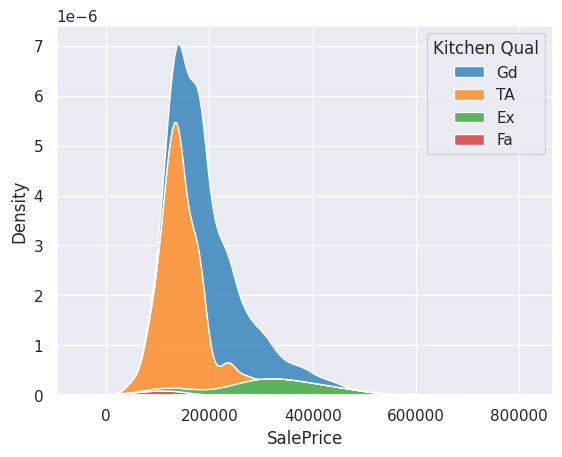

In [ ]:
sns.kdeplot(data=df , x='SalePrice', hue='Kitchen Qual', multiple='stack', palette='tab10');

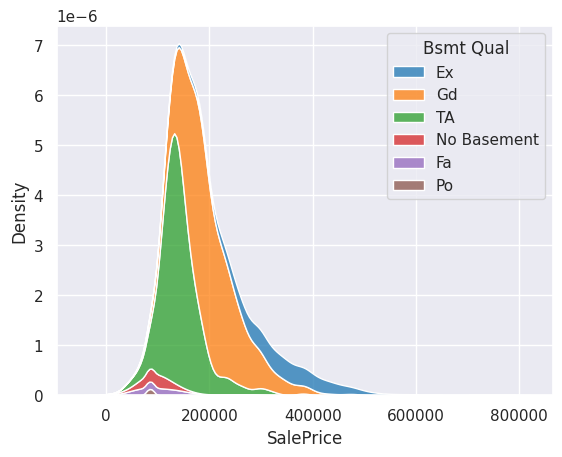

In [ ]:
sns.kdeplot(data=df , x='SalePrice', hue='Bsmt Qual', multiple='stack', palette='tab10')

<Axes: xlabel='SalePrice', ylabel='Density'>

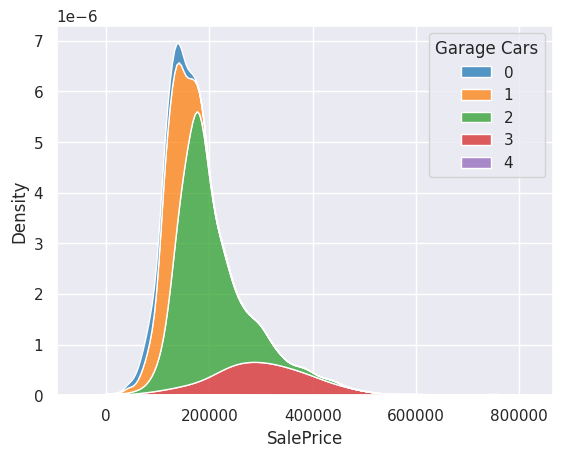

In [ ]:
sns.kdeplot(data=df , x='SalePrice', hue='Garage Cars', multiple='stack', palette='tab10')

<Axes: xlabel='SalePrice', ylabel='Density'>

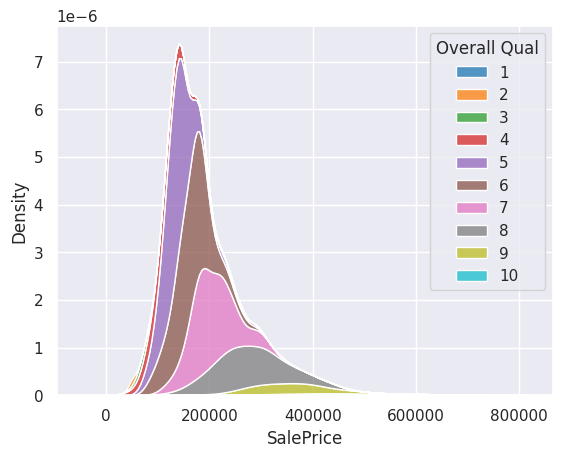

In [ ]:
sns.kdeplot(data=df , x='SalePrice', hue='Overall Qual', multiple='stack', palette='tab10')

<Axes: xlabel='Garage Area', ylabel='SalePrice'>

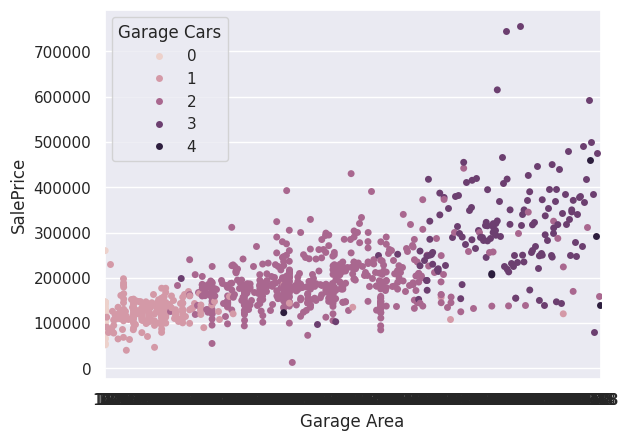

In [ ]:
sns.stripplot(x="Garage Area", y="SalePrice",hue = 'Garage Cars', data=df)

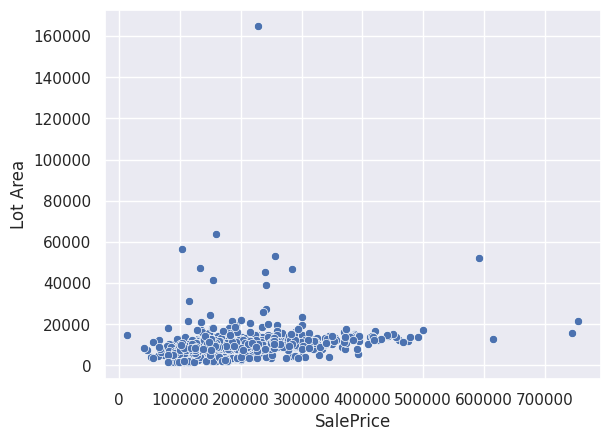

In [ ]:
sns.scatterplot(x = 'SalePrice', y = 'Lot Area', data = df);

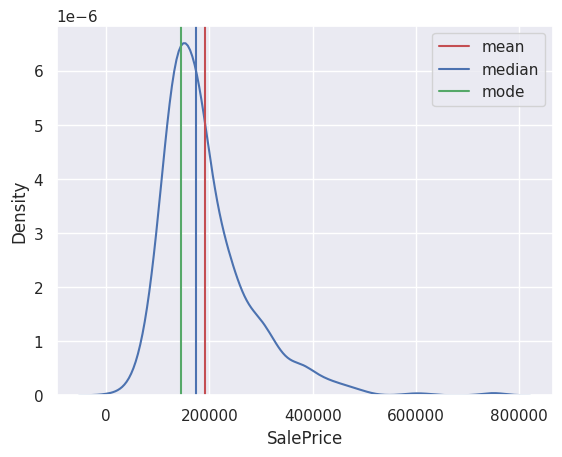

In [ ]:
a=df['SalePrice']
mean=a.mean()
median=np.median(a)
mode=a.mode()
sns.distplot(a,hist=False)
plt.axvline(mean,color='r',label='mean')
plt.axvline(median,color='b',label='median')
plt.axvline(mode[0],color='g',label='mode')
plt.legend()
plt.show()

<Axes: xlabel='Land Contour'>

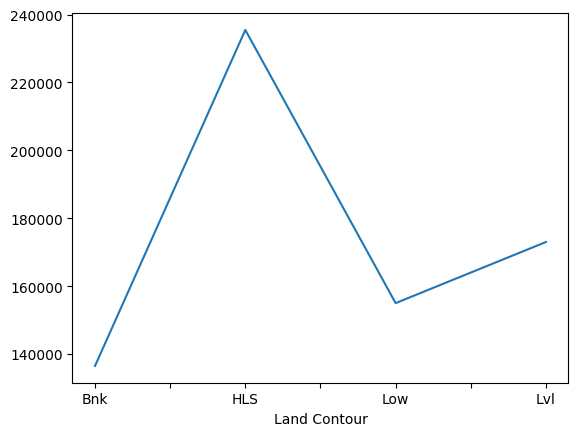

In [ ]:
df.groupby('Land Contour')['SalePrice'].median().plot()

houses that are on a a hillside are the most expensive

<Axes: xlabel='Fireplaces'>

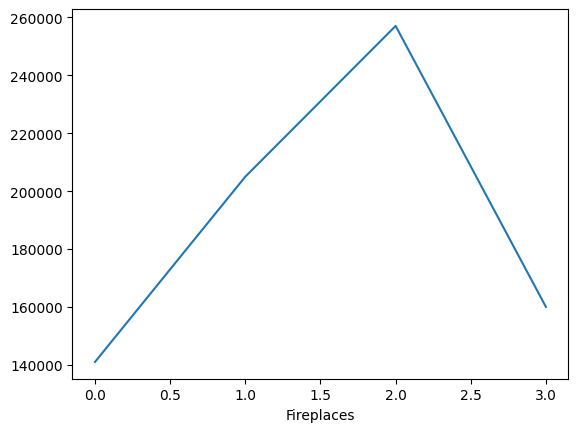

In [ ]:
df.groupby('Fireplaces')['SalePrice'].median().plot()

<Axes: xlabel='Year Built'>

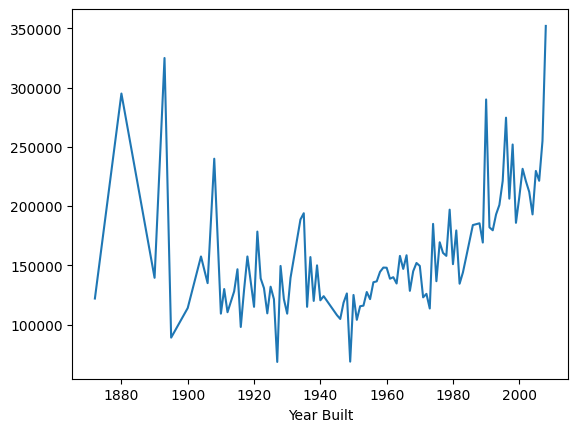

In [ ]:
df.groupby('Year Built')['SalePrice'].median().plot()

sprice fluctuates segnificently but houses built between 1900 and 1980 are the cheapest

<Axes: xlabel='Year Remod/Add'>

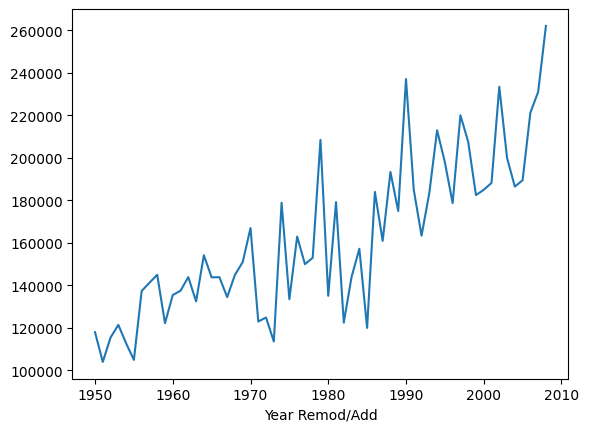

In [ ]:
df.groupby('Year Remod/Add')['SalePrice'].median().plot()

<Axes: xlabel='Pool Area'>

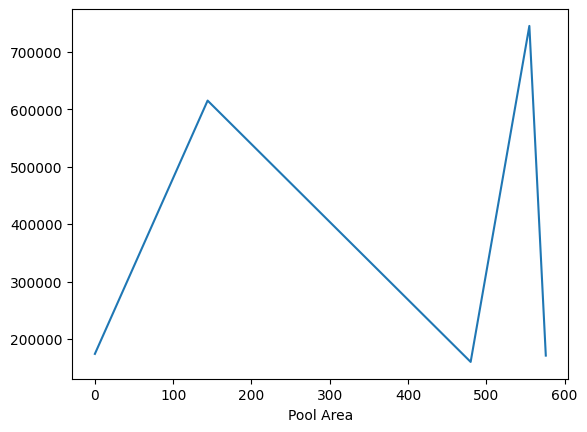

In [ ]:
df.groupby('Pool Area')['SalePrice'].median().plot()

<Axes: xlabel='Sale Condition'>

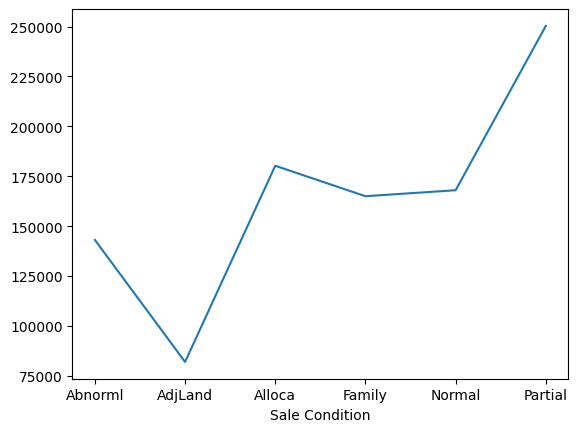

In [ ]:
df.groupby('Sale Condition')['SalePrice'].median().plot()

<Axes: xlabel='Mo Sold'>

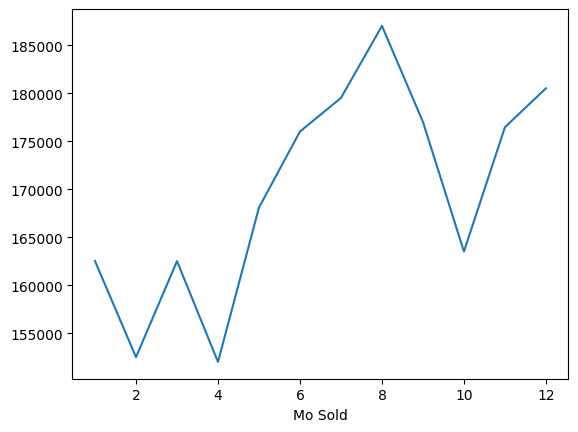

In [ ]:
df.groupby('Mo Sold')['SalePrice'].median().plot()

sales in month 8 and around it in the highest throughout the years

In [ ]:
df.head()

,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,120,RL,45.0,6264,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,5,1997,1997,Gable,CompShg,CemntBd,CmentBd,no mas vnr,0.0,Gd,TA,PConc,Ex,TA,Mn,GLQ,656.0,Unf,0.0,1008.0,1664.0,GasA,Ex,Y,SBrkr,1682,0,0,1682,1.0,0.0,1,1,1,1,Gd,6,Min1,1,TA,Attchd,1997.0,Fin,2,528,TA,TA,Y,0,0,0,0,0,0,No Pool,No Fence,No Misc Feature,0,7,2008,WD,Normal,247900
1,120,RL,41.0,5395,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1993,1993,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,733.0,Unf,0.0,604.0,1337.0,GasA,Gd,Y,SBrkr,1337,0,0,1337,1.0,0.0,2,0,2,1,Gd,5,Typ,1,TA,Attchd,1993.0,RFn,2,462,TA,TA,Y,96,0,70,168,0,0,No Pool,No Fence,No Misc Feature,0,10,2008,WD,Normal,180000
2,120,RL,39.0,5070,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,1280.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1992.0,RFn,2,506,TA,TA,Y,0,82,0,0,144,0,No Pool,No Fence,No Misc Feature,0,8,2008,WD,Normal,180000
3,60,RL,100.0,10839,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,926.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1997.0,Fin,2,470,TA,TA,Y,0,36,0,0,0,0,No Pool,No Fence,No Misc Feature,0,7,2008,WD,Normal,181000
4,60,RL,73.0,11184,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,932.0,932.0,GasA,Gd,Y,SBrkr,932,701,0,1633,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1998.0,Fin,2,460,TA,TA,Y,0,39,0,0,0,0,No Pool,No Fence,No Misc Feature,0,4,2008,WD,Family,183000


In [ ]:
df['Yr Sold'] - df['Year Built']

<Axes: xlabel='diff'>

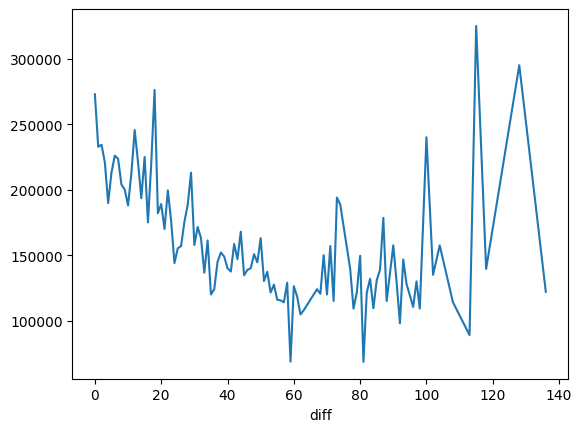

In [ ]:
test = pd.DataFrame()
test['diff'] = df['Yr Sold'] - df['Year Built']
test['SalePrice'] = df['SalePrice']
test.groupby('diff')['SalePrice'].median().plot()

<Axes: xlabel='Neighborhood'>

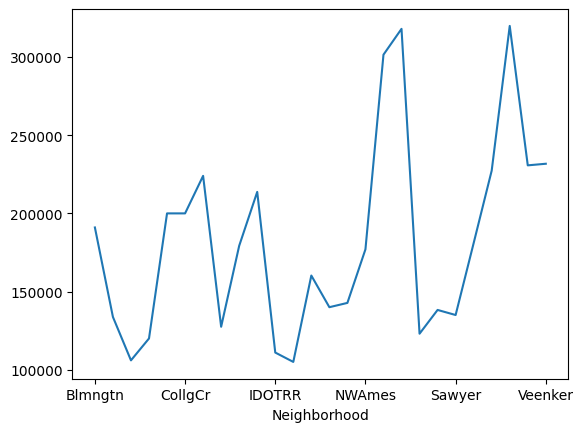

In [ ]:
df.groupby('Neighborhood')['SalePrice'].median().plot()

<Axes: xlabel='Alley'>

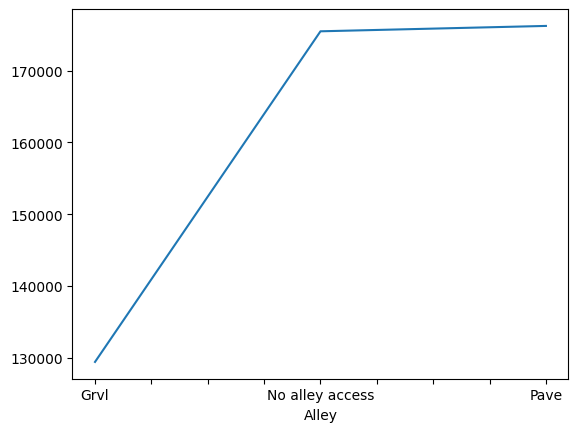

In [ ]:
df.groupby('Alley')['SalePrice'].median().plot()

prices increase for houses with no alley access or have a pave

<Axes: xlabel='SalePrice', ylabel='Neighborhood'>

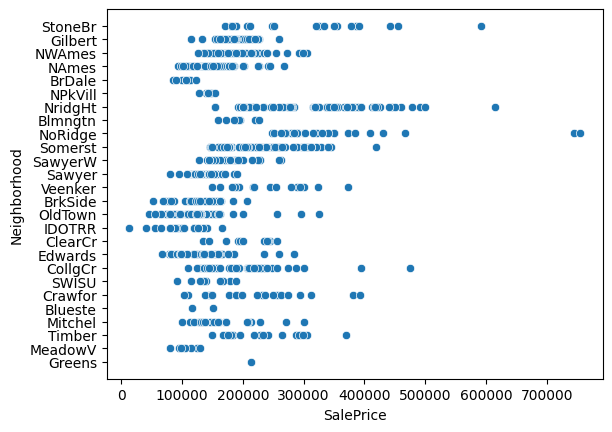

In [ ]:
sns.scatterplot(x = df['SalePrice'], y = df['Neighborhood'])

the Neighborhood doesnet add much

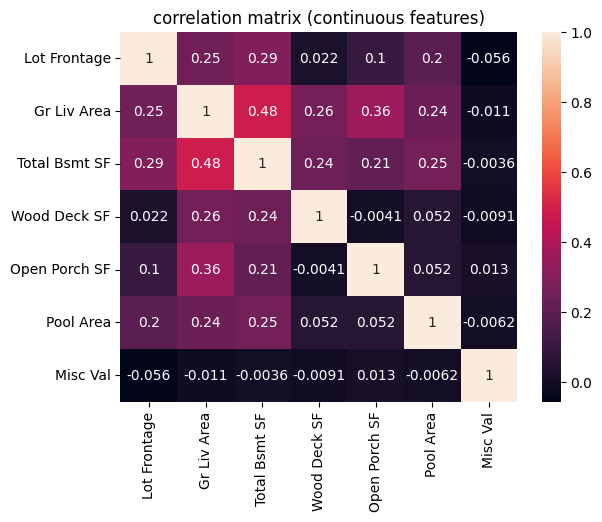

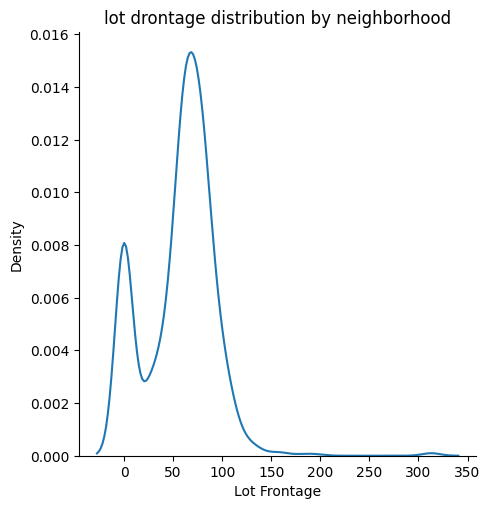

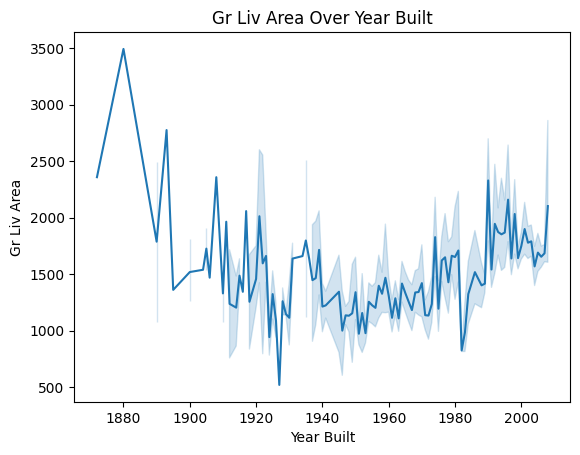

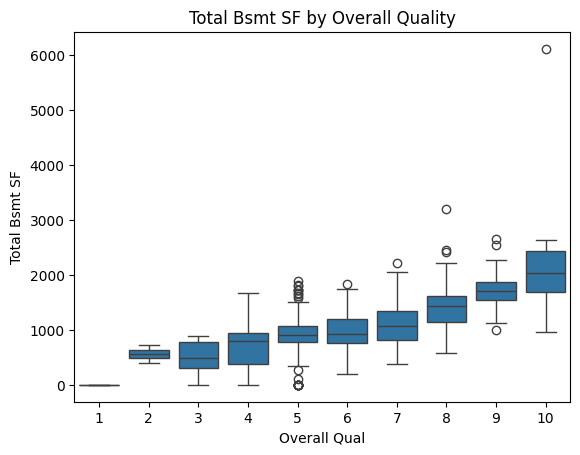

In [ ]:

cont_features = ['Lot Frontage', 'Gr Liv Area', 'Total Bsmt SF', 'Wood Deck SF',
                 'Open Porch SF',  'Pool Area', 'Misc Val']

cat_features = ['MS Zoning', 'Neighborhood', 'Overall Qual', 'House Style']

corr_matrix = df[cont_features].corr()
sns.heatmap(corr_matrix, annot=True)
plt.title('correlation matrix (continuous features)')
plt.show()

sns.displot(df[cont_features[0]], kind='kde')
plt.title('lot drontage distribution by neighborhood')
plt.show()

if 'Year Built' in df.columns:
  sns.lineplot(x='Year Built', y=cont_features[1], data=df)
  plt.title('Gr Liv Area Over Year Built')
  plt.show()

sns.boxplot(x='Overall Qual', y=cont_features[2], data=df)
plt.title('Total Bsmt SF by Overall Quality')
plt.show()


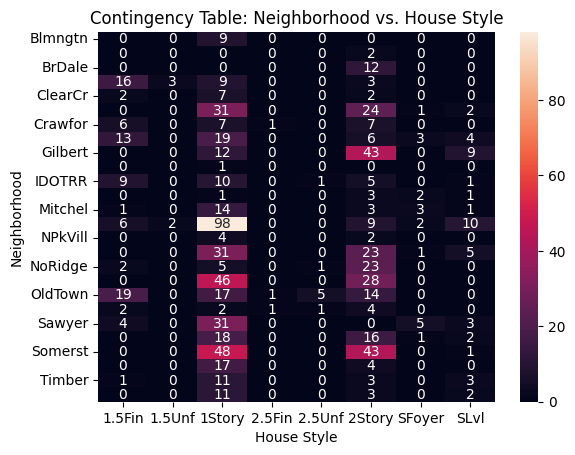

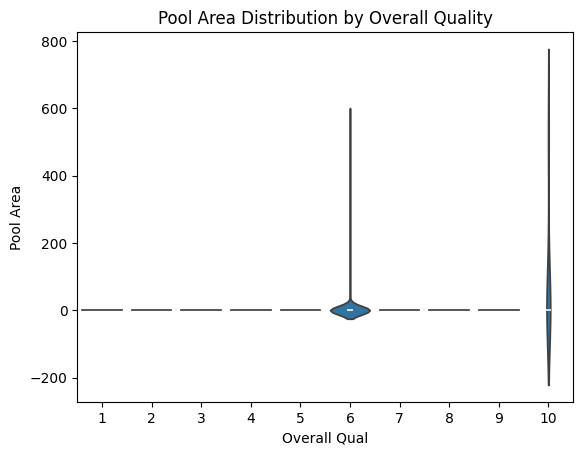

In [ ]:

cont_features = ['Lot Frontage', 'Gr Liv Area', 'Total Bsmt SF', 'Wood Deck SF',
                 'Open Porch SF', 'Enclosed Porch SF', 'Pool Area', 'Misc Val']
cat_features = ['MS Zoning', 'Neighborhood', 'Overall Qual', 'House Style']

contingency_table = pd.crosstab(df['Neighborhood'], df['House Style'])
sns.heatmap(contingency_table, annot=True, fmt='d')
plt.title('Contingency Table: neighborhood vs. house style')
plt.show()

sns.violinplot(x='Overall Qual', y='Pool Area', data=df.dropna(subset=['Pool Area']))
plt.title('pool area Distribution by overall quality')
plt.show()



array([[<Axes: title={'center': 'MS SubClass'}>,
        <Axes: title={'center': 'Lot Frontage'}>,
        <Axes: title={'center': 'Lot Area'}>,
        <Axes: title={'center': 'Overall Qual'}>,
        <Axes: title={'center': 'Overall Cond'}>,
        <Axes: title={'center': 'Year Built'}>],
       [<Axes: title={'center': 'Year Remod/Add'}>,
        <Axes: title={'center': 'Mas Vnr Area'}>,
        <Axes: title={'center': 'BsmtFin SF 1'}>,
        <Axes: title={'center': 'BsmtFin SF 2'}>,
        <Axes: title={'center': 'Bsmt Unf SF'}>,
        <Axes: title={'center': 'Total Bsmt SF'}>],
       [<Axes: title={'center': '1st Flr SF'}>,
        <Axes: title={'center': '2nd Flr SF'}>,
        <Axes: title={'center': 'Low Qual Fin SF'}>,
        <Axes: title={'center': 'Gr Liv Area'}>,
        <Axes: title={'center': 'Bsmt Full Bath'}>,
        <Axes: title={'center': 'Bsmt Half Bath'}>],
       [<Axes: title={'center': 'Full Bath'}>,
        <Axes: title={'center': 'Half Bath'}>,
      

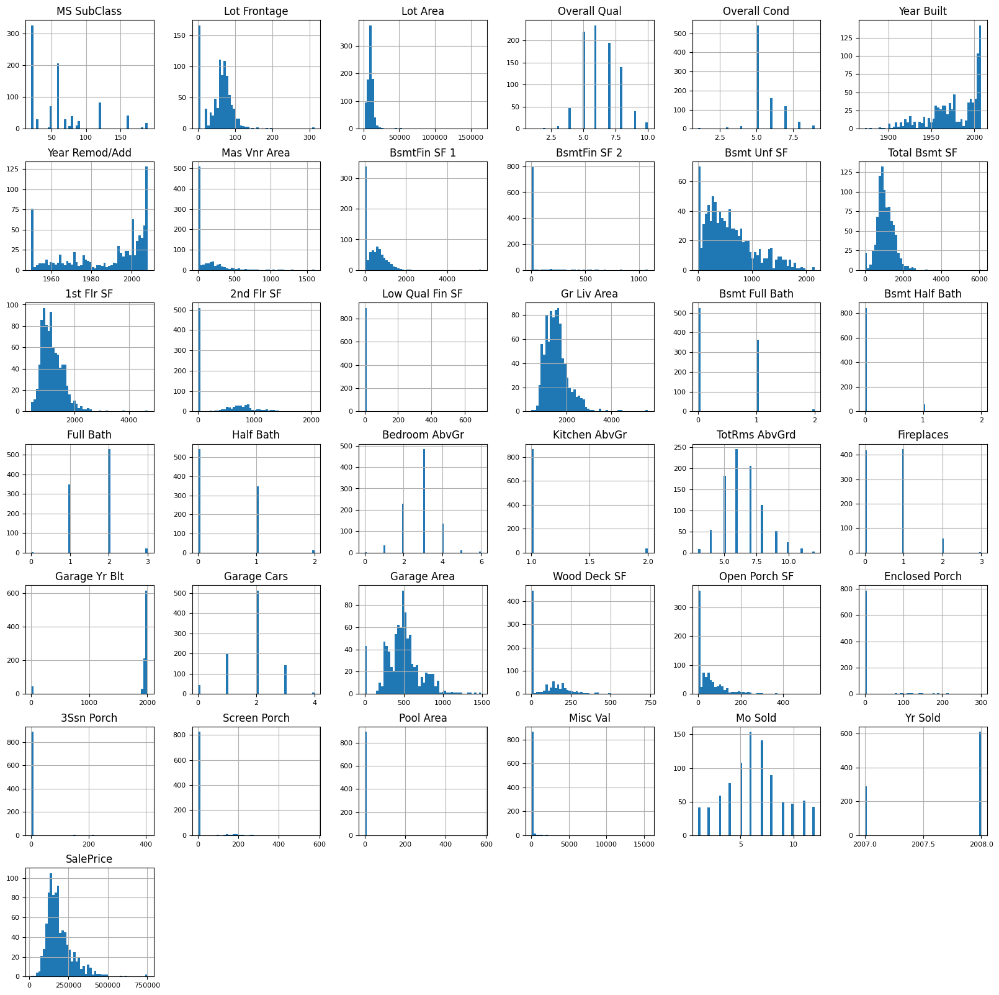

In [ ]:
df[num_features].hist(figsize=(20, 20), bins=50, xlabelsize=8, ylabelsize=8)

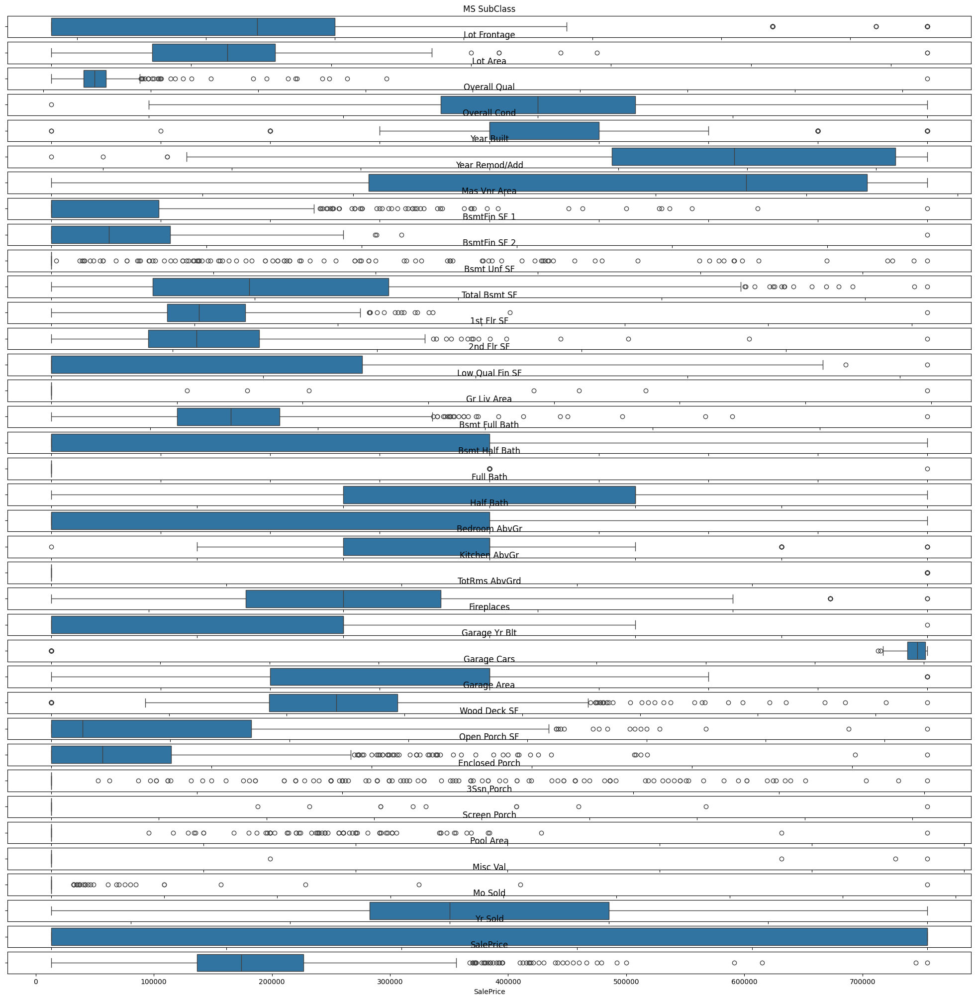

In [ ]:
fig, axes = plt.subplots(len(num_features), figsize=(25, 25))

for i, feature in enumerate(num_features):
    sns.boxplot(x=df[feature], ax=axes[i])
    plt.xlabel(feature)
    axes[i].set_title(feature, fontsize=12)


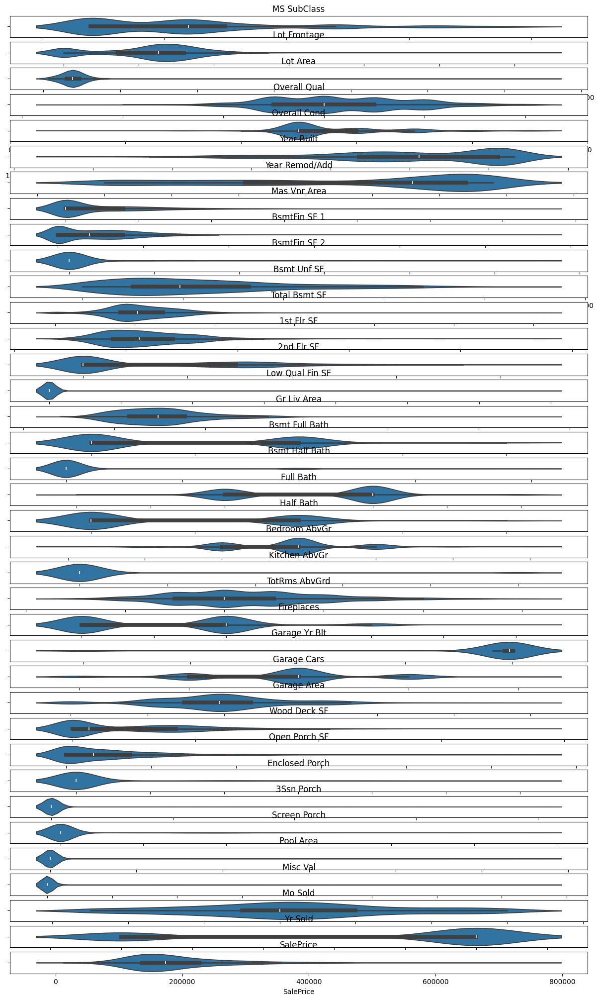

In [ ]:
fig, axes = plt.subplots(len(num_features), figsize=(15, 25))

for i, feature in enumerate(num_features):
    sns.violinplot(x=df[feature], ax=axes[i])
    plt.xlabel(feature)
    axes[i].set_title(feature, fontsize=12)

the zeroes in the dataset most of them means that this feature is not in this house so i had to visualize some plotes to see the difference between the plots withthe zeroes and without them

In [ ]:
detect_box_voilin_hist(df, continous_feat)

In [ ]:
detect_box_voilin_hist_exclude_zeros(df,continous_feat)

In [ ]:
df['Overall Cond'].unique()

array([1, 2, 3, 4, 5, 6, 7, 8, 9])


 
 ------------------- MS SubClass ------------------- 

Outliers of  MS SubClass  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]
before lower bound of  MS SubClass  :  []
after upper bound of  MS SubClass  :  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190]


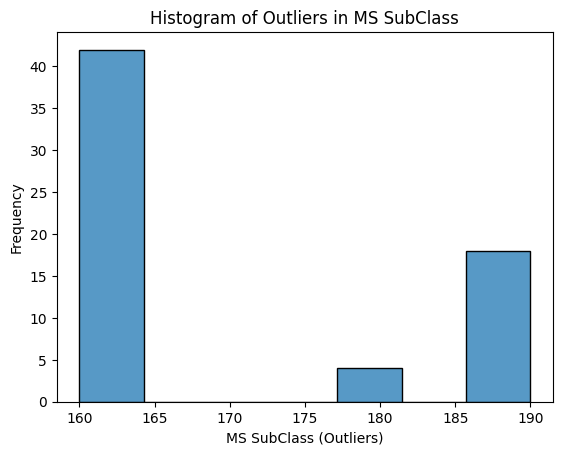


 
 ------------------- Lot Frontage ------------------- 

Outliers of  Lot Frontage  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0]
before lower bound of  Lot Frontage  :  []
after upper bound of  Lot Frontage  :  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0]


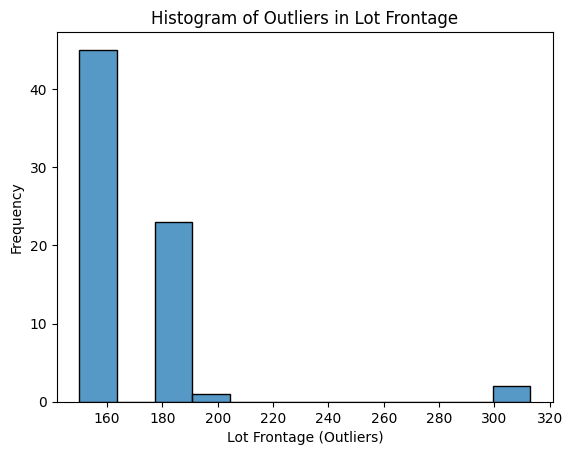


 
 ------------------- Lot Area ------------------- 

Outliers of  Lot Area  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660]
before lower bound of  Lot Area  :  []
after upper bound of  Lot Area  :  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190

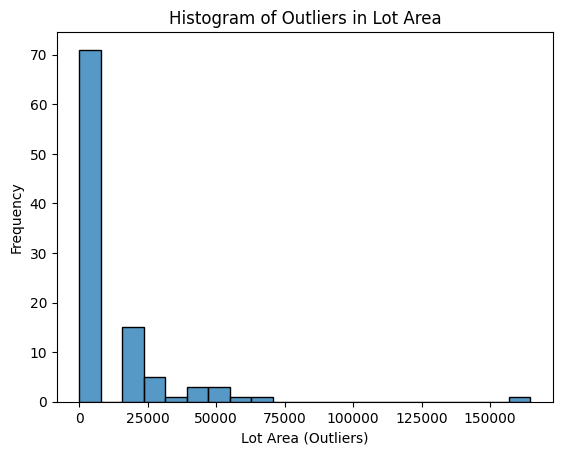


 
 ------------------- Overall Qual ------------------- 

Outliers of  Overall Qual  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1]
before lower bound of  Overall Qual  :  [1]
after upper bound of  Overall Qual  :  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180

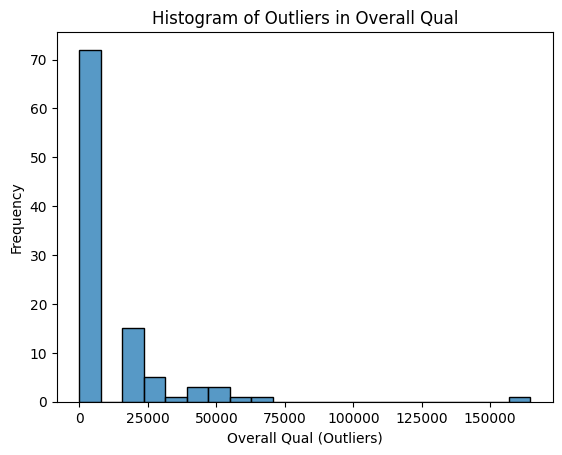


 
 ------------------- Overall Cond ------------------- 

Outliers of  Overall Cond  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9]
before lower bound of  Overall Cond  :  [1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3]
after upper bound of  Overall Cond  :

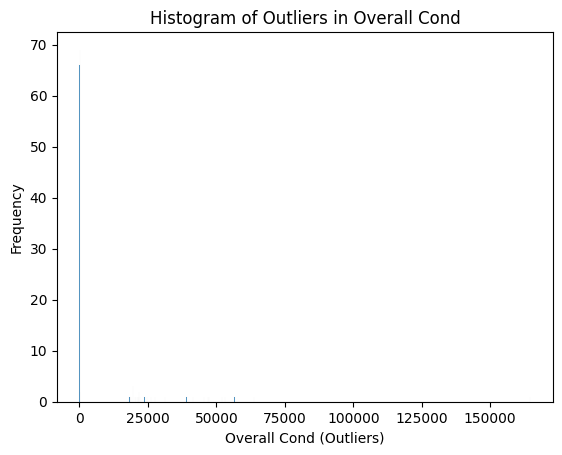


 
 ------------------- Year Built ------------------- 

Outliers of  Year Built  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890]
before lower bound of  Year Built  :  [1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 1872, 1880, 1890, 1

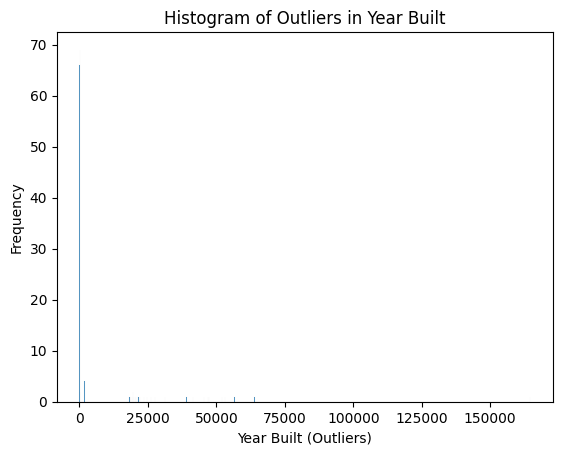


 
 ------------------- Year Remod/Add ------------------- 

Outliers of  Year Remod/Add  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890]
before lower bound of  Year Remod/Add  :  [1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 1872, 1

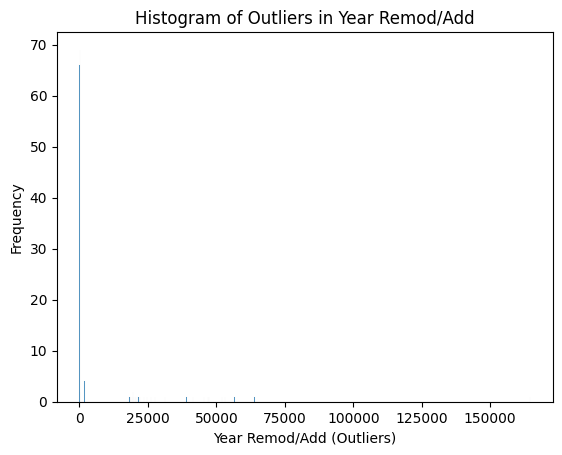


 
 ------------------- Mas Vnr Area ------------------- 

Outliers of  Mas Vnr Area  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 55

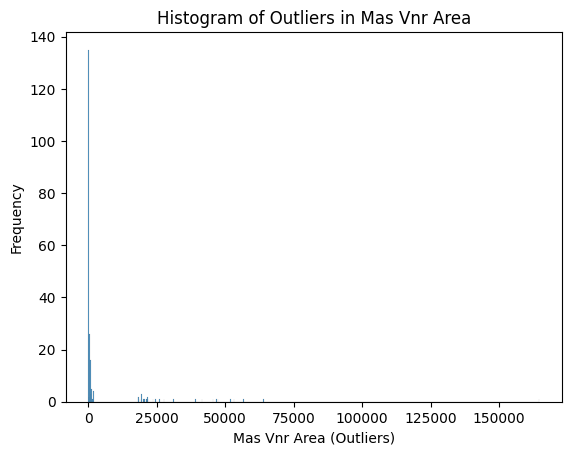


 
 ------------------- BsmtFin SF 1 ------------------- 

Outliers of  BsmtFin SF 1  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 55

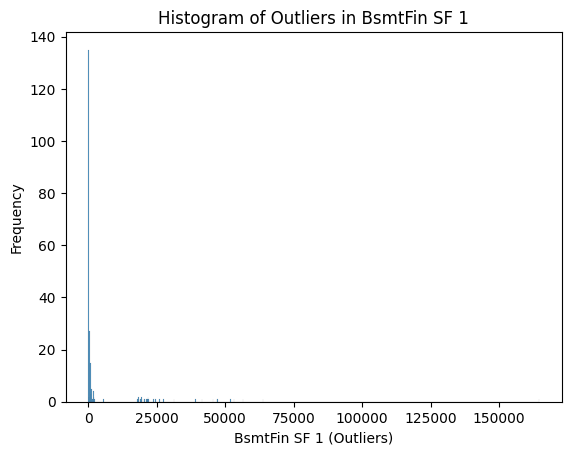


 
 ------------------- BsmtFin SF 2 ------------------- 

Outliers of  BsmtFin SF 2  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 55

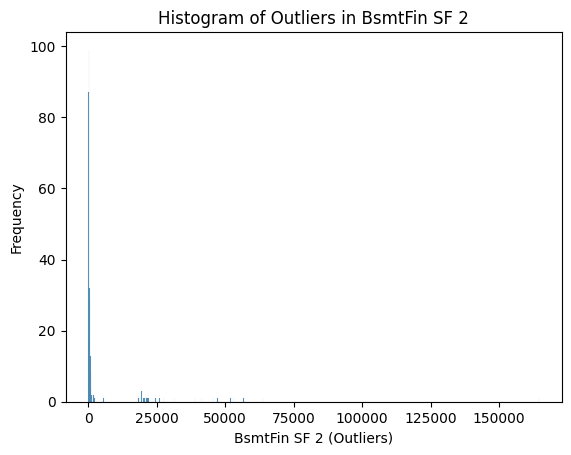


 
 ------------------- Bsmt Unf SF ------------------- 

Outliers of  Bsmt Unf SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.

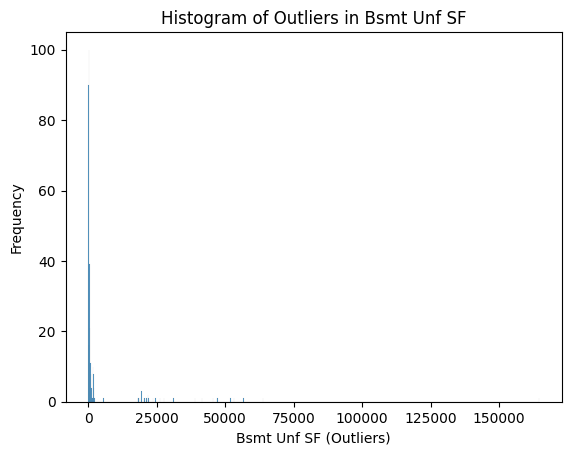


 
 ------------------- Total Bsmt SF ------------------- 

Outliers of  Total Bsmt SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 

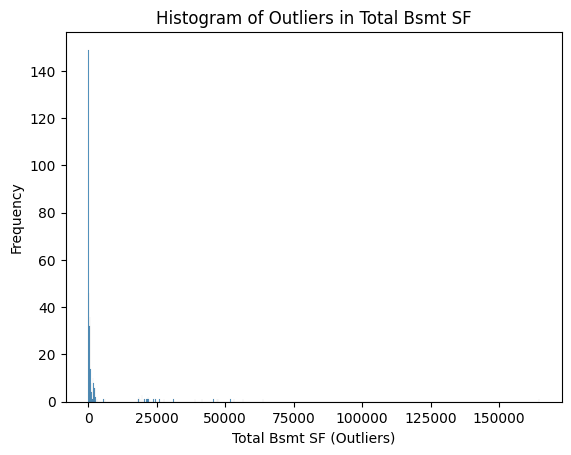


 
 ------------------- 1st Flr SF ------------------- 

Outliers of  1st Flr SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0,

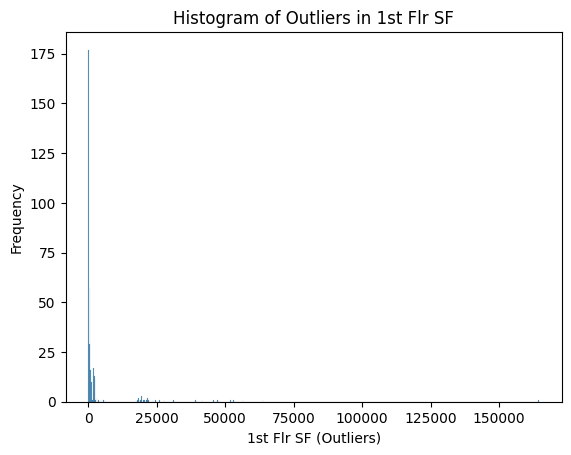


 
 ------------------- 2nd Flr SF ------------------- 

Outliers of  2nd Flr SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0,

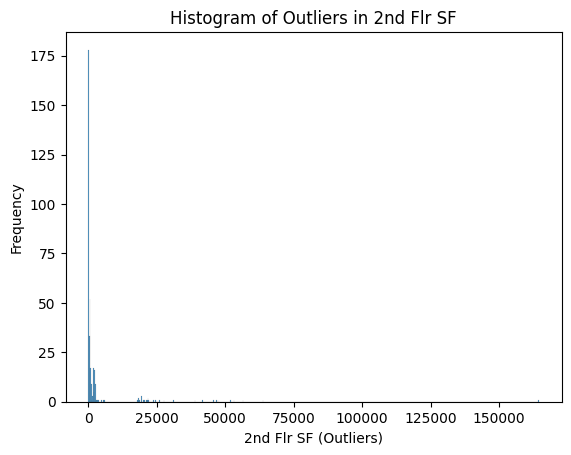


 
 ------------------- Low Qual Fin SF ------------------- 

Outliers of  Low Qual Fin SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549

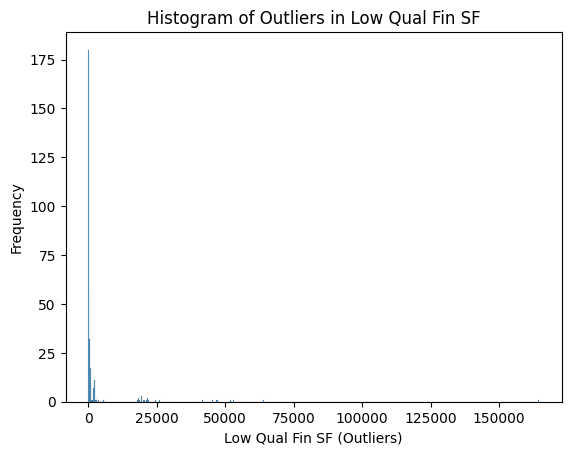


 
 ------------------- Gr Liv Area ------------------- 

Outliers of  Gr Liv Area  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.

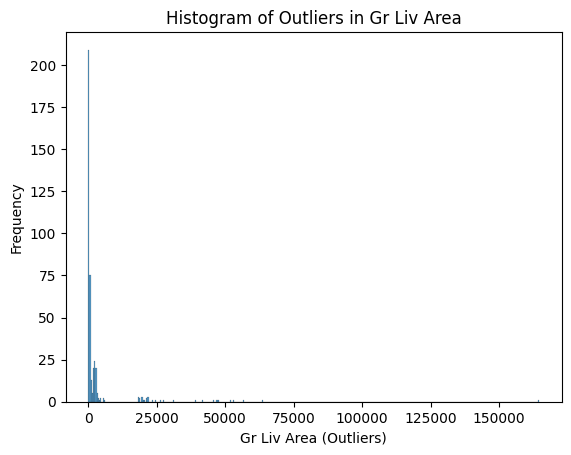


 
 ------------------- Bsmt Full Bath ------------------- 

Outliers of  Bsmt Full Bath  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0

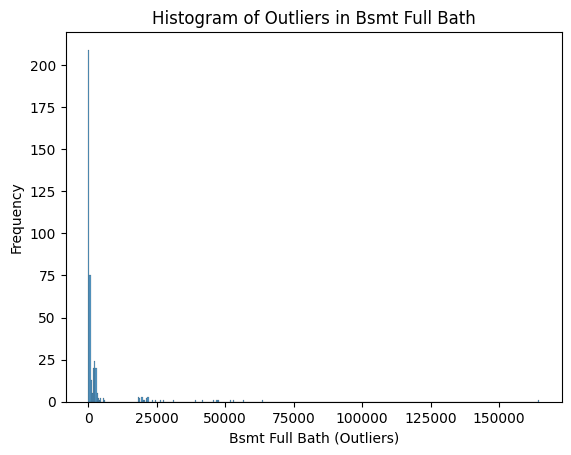


 
 ------------------- Bsmt Half Bath ------------------- 

Outliers of  Bsmt Half Bath  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0

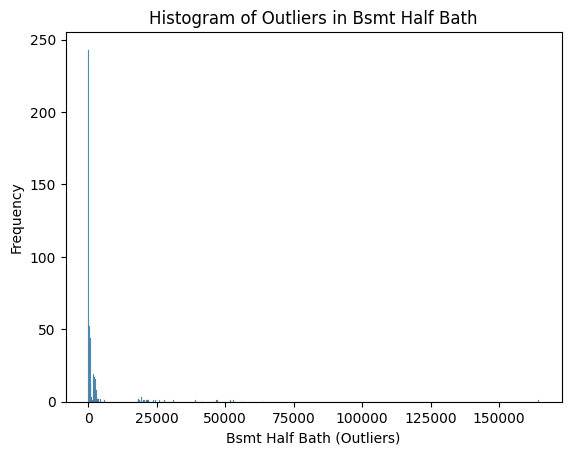


 
 ------------------- Full Bath ------------------- 

Outliers of  Full Bath  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 5

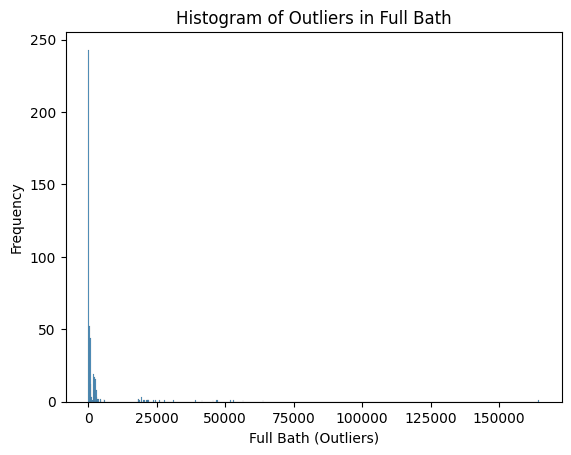


 
 ------------------- Half Bath ------------------- 

Outliers of  Half Bath  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 5

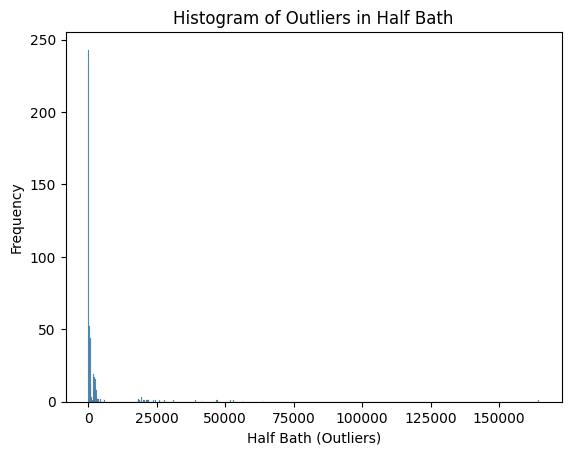


 
 ------------------- Bedroom AbvGr ------------------- 

Outliers of  Bedroom AbvGr  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 

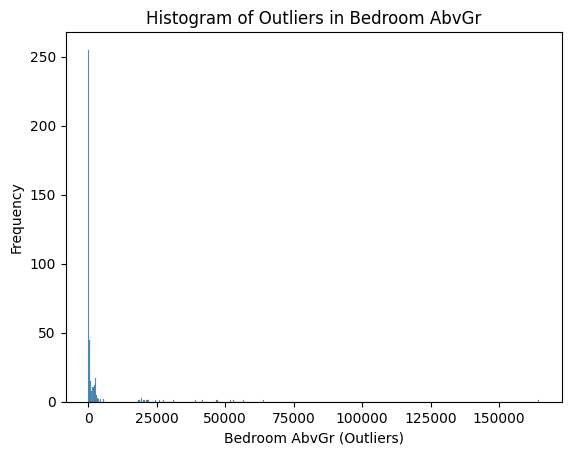


 
 ------------------- Kitchen AbvGr ------------------- 

Outliers of  Kitchen AbvGr  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 

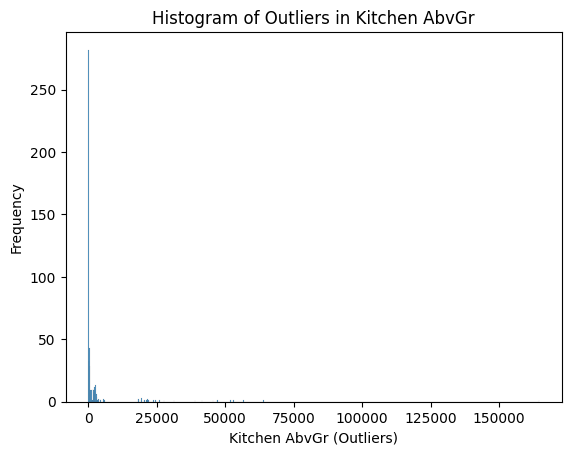


 
 ------------------- TotRms AbvGrd ------------------- 

Outliers of  TotRms AbvGrd  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 

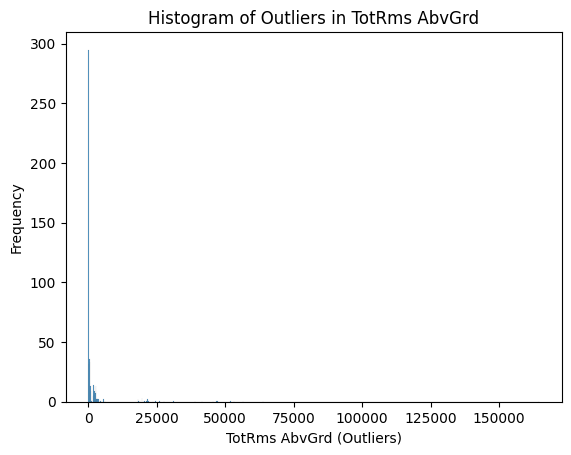


 
 ------------------- Fireplaces ------------------- 

Outliers of  Fireplaces  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0,

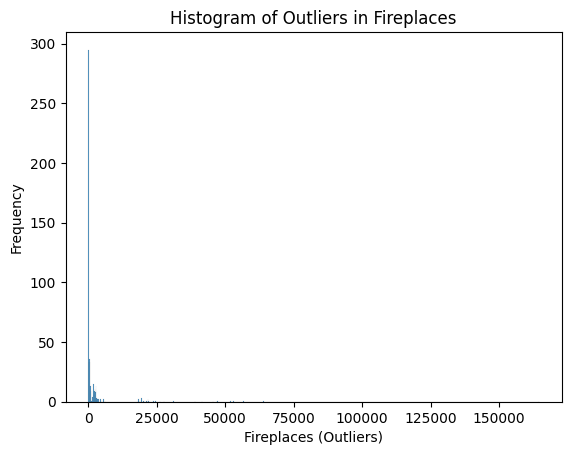


 
 ------------------- Garage Yr Blt ------------------- 

Outliers of  Garage Yr Blt  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 

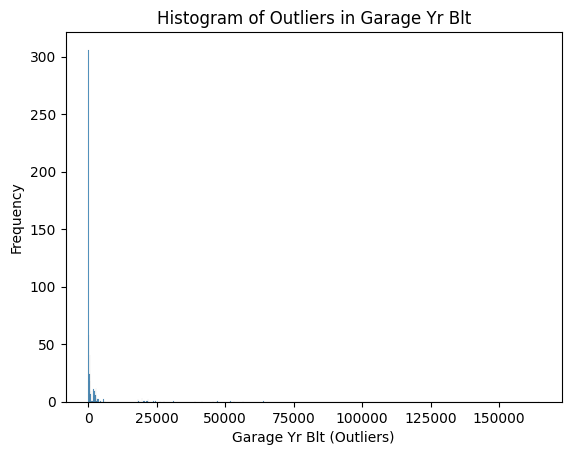


 
 ------------------- Garage Cars ------------------- 

Outliers of  Garage Cars  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.

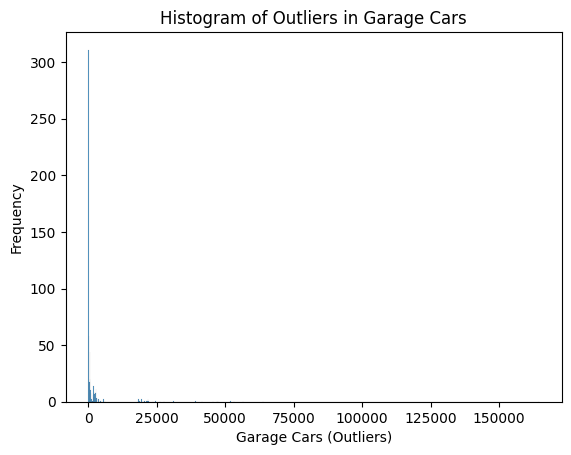


 
 ------------------- Garage Area ------------------- 

Outliers of  Garage Area  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.

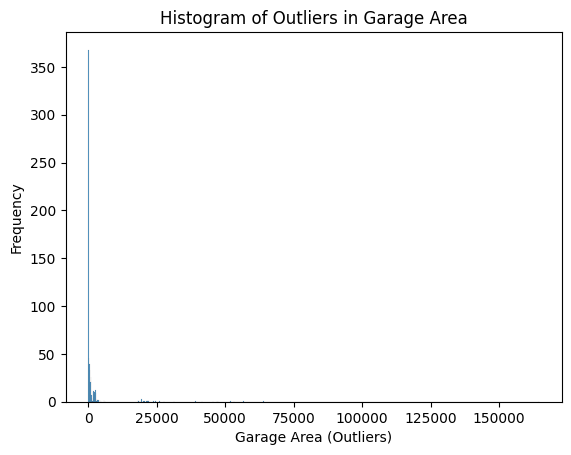


 
 ------------------- Wood Deck SF ------------------- 

Outliers of  Wood Deck SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 55

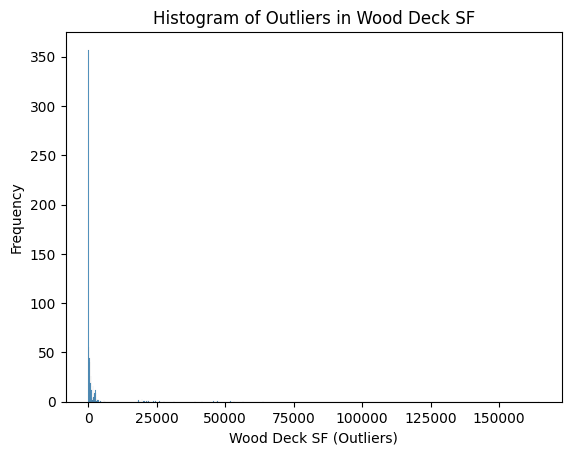


 
 ------------------- Open Porch SF ------------------- 

Outliers of  Open Porch SF  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 

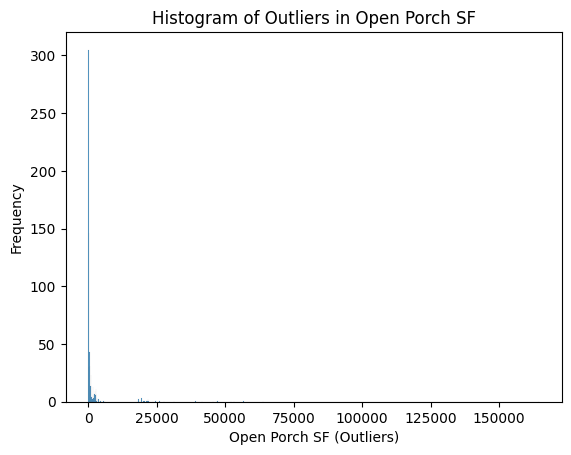


 
 ------------------- Enclosed Porch ------------------- 

Outliers of  Enclosed Porch  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0

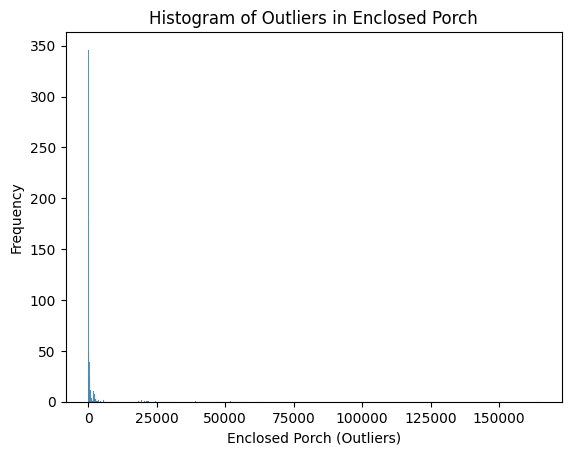


 
 ------------------- 3Ssn Porch ------------------- 

Outliers of  3Ssn Porch  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0,

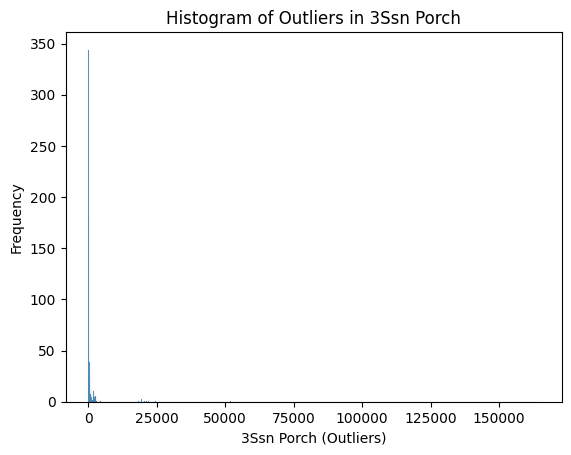


 
 ------------------- Screen Porch ------------------- 

Outliers of  Screen Porch  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 55

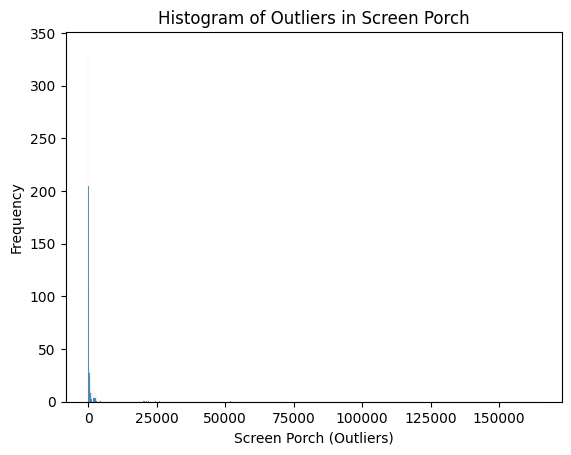


 
 ------------------- Pool Area ------------------- 

Outliers of  Pool Area  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 5

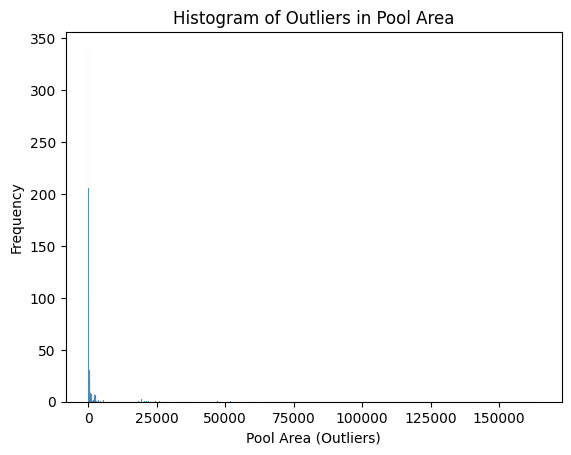


 
 ------------------- Misc Val ------------------- 

Outliers of  Misc Val  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 554

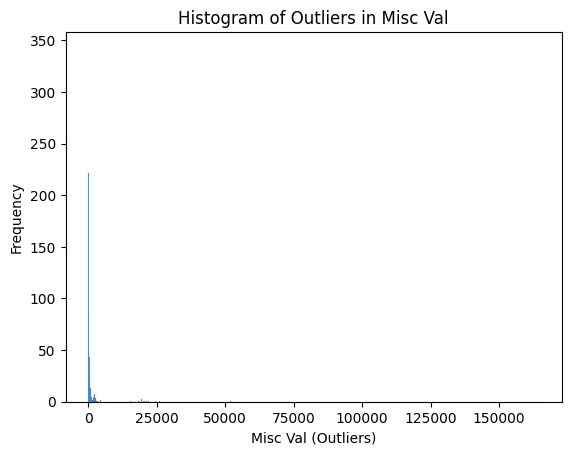


 
 ------------------- Mo Sold ------------------- 

Outliers of  Mo Sold  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 554.0

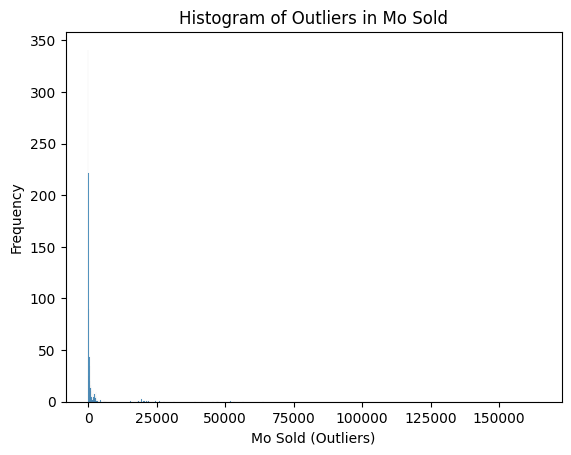


 
 ------------------- Yr Sold ------------------- 

Outliers of  Yr Sold  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 554.0

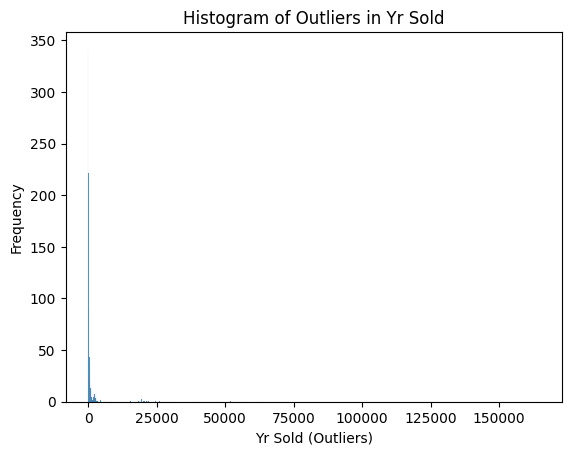


 
 ------------------- SalePrice ------------------- 

Outliers of  SalePrice  from IQR method:  [160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 150.0, 160.0, 160.0, 182.0, 195.0, 313.0, 313.0, 18160, 18265, 18386, 18559, 18890, 19508, 19522, 19550, 20270, 20544, 21286, 21535, 21750, 21780, 22002, 23730, 24572, 26073, 27650, 31220, 39104, 41600, 45600, 47007, 47280, 51974, 53227, 56600, 63887, 164660, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 1872, 1880, 1890, 1890, 491.0, 492.0, 495.0, 502.0, 504.0, 510.0, 513.0, 513.0, 513.0, 515.0, 525.0, 526.0, 549.0, 554.0, 5

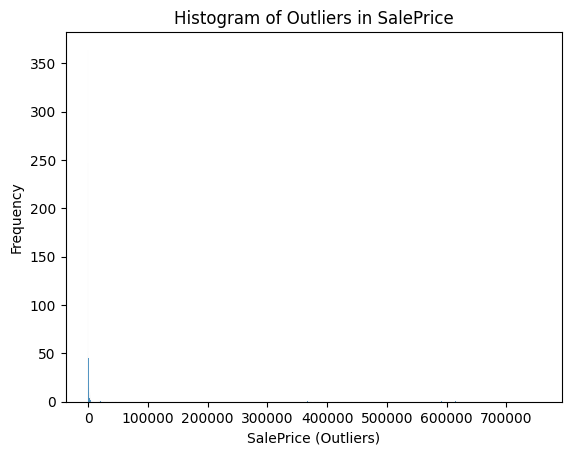

In [ ]:
detect_outliers_iqr(df,continous_feat)


 
 ------------------- MS SubClass -------------------
Outliers of MS SubClass from IQR method:  length: 64  -  {160, 180, 190}
before lower bound of MS SubClass : length: 0  -  set()
after upper bound of MS SubClass : length: 64  -  {160, 180, 190}


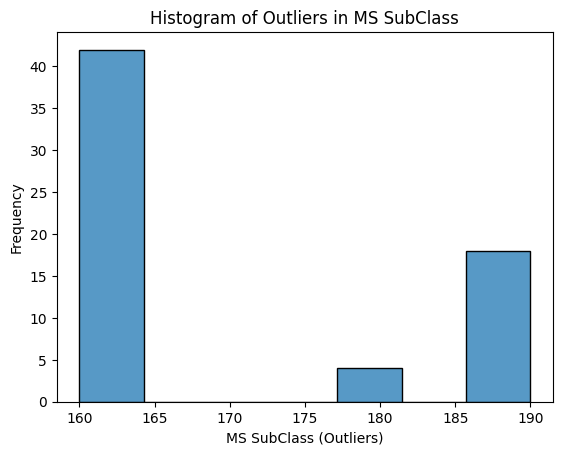


 
 ------------------- Lot Frontage -------------------
Outliers of Lot Frontage from IQR method:  length: 52  -  {128.0, 130.0, 134.0, 135.0, 136.0, 21.0, 22.0, 150.0, 24.0, 160.0, 182.0, 313.0, 195.0, 115.0, 116.0, 118.0, 120.0, 123.0, 124.0}
before lower bound of Lot Frontage : length: 32  -  {24.0, 21.0, 22.0}
after upper bound of Lot Frontage : length: 20  -  {128.0, 160.0, 130.0, 195.0, 134.0, 135.0, 136.0, 313.0, 115.0, 116.0, 118.0, 150.0, 120.0, 182.0, 123.0, 124.0}


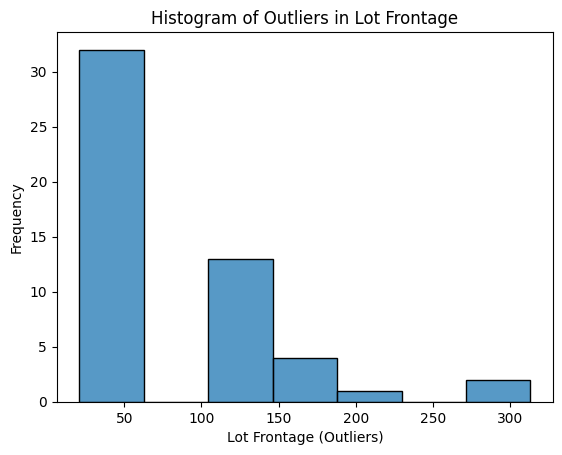


 
 ------------------- Lot Area -------------------
Outliers of Lot Area from IQR method:  length: 30  -  {41600, 27650, 51974, 63887, 21780, 56600, 21535, 45600, 47007, 21286, 20270, 47280, 23730, 19508, 164660, 20544, 39104, 19522, 18890, 18386, 26073, 18265, 19550, 53227, 18160, 22002, 31220, 21750, 24572, 18559}
before lower bound of Lot Area : length: 0  -  set()
after upper bound of Lot Area : length: 30  -  {41600, 27650, 51974, 63887, 21780, 56600, 21535, 45600, 47007, 21286, 20270, 47280, 23730, 19508, 164660, 20544, 39104, 19522, 18890, 18386, 26073, 18265, 19550, 53227, 18160, 22002, 31220, 21750, 24572, 18559}


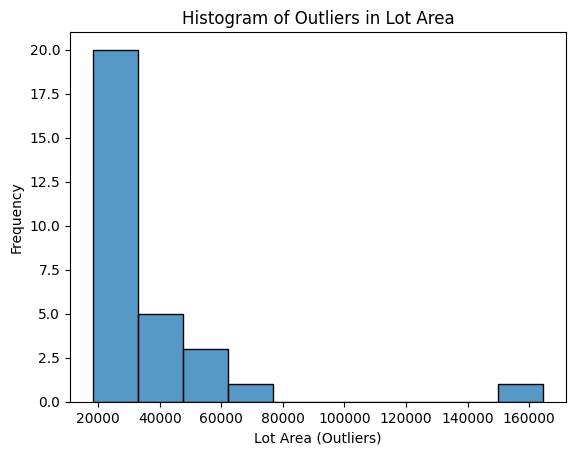


 
 ------------------- Overall Qual -------------------
Outliers of Overall Qual from IQR method:  length: 1  -  {1}
before lower bound of Overall Qual : length: 1  -  {1}
after upper bound of Overall Qual : length: 0  -  set()


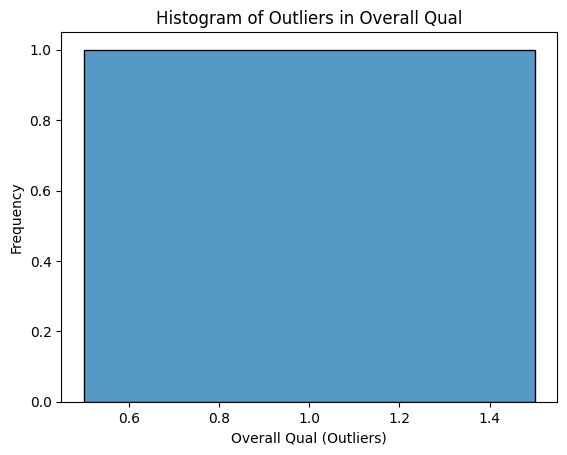


 
 ------------------- Overall Cond -------------------
Outliers of Overall Cond from IQR method:  length: 65  -  {1, 2, 3, 8, 9}
before lower bound of Overall Cond : length: 12  -  {1, 2, 3}
after upper bound of Overall Cond : length: 53  -  {8, 9}


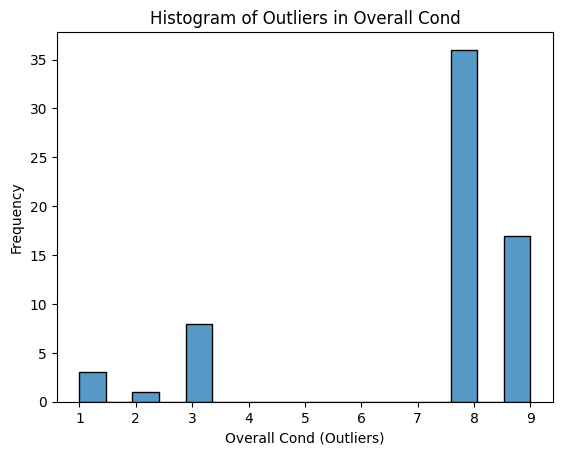


 
 ------------------- Year Built -------------------
Outliers of Year Built from IQR method:  length: 4  -  {1872, 1890, 1880}
before lower bound of Year Built : length: 4  -  {1872, 1890, 1880}
after upper bound of Year Built : length: 0  -  set()


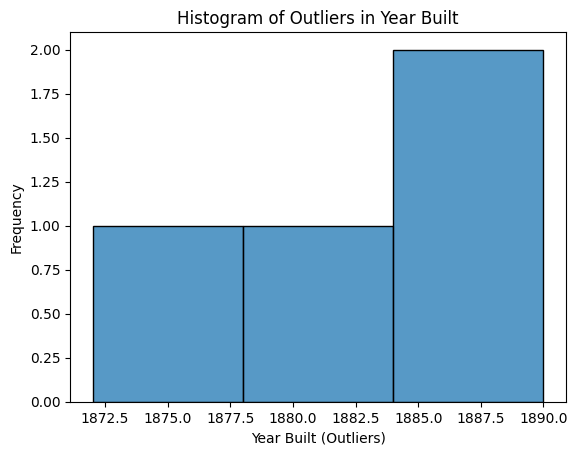


 
 ------------------- Year Remod/Add -------------------
Outliers of Year Remod/Add from IQR method:  length: 0  -  set()
before lower bound of Year Remod/Add : length: 0  -  set()
after upper bound of Year Remod/Add : length: 0  -  set()

 
 ------------------- Mas Vnr Area -------------------
Outliers of Mas Vnr Area from IQR method:  length: 24  -  {768.0, 772.0, 1290.0, 1170.0, 660.0, 664.0, 1050.0, 796.0, 668.0, 674.0, 680.0, 816.0, 945.0, 1600.0, 705.0, 710.0, 714.0, 970.0, 1110.0, 1115.0, 1129.0, 754.0, 766.0}
before lower bound of Mas Vnr Area : length: 0  -  set()
after upper bound of Mas Vnr Area : length: 24  -  {768.0, 772.0, 1290.0, 1170.0, 660.0, 664.0, 1050.0, 796.0, 668.0, 674.0, 680.0, 816.0, 945.0, 1600.0, 705.0, 710.0, 714.0, 970.0, 1110.0, 1115.0, 1129.0, 754.0, 766.0}


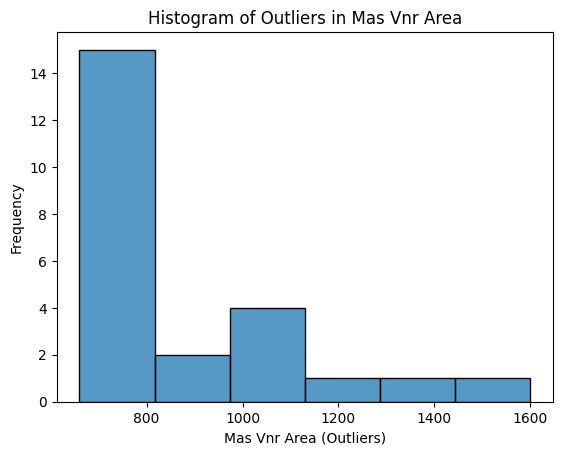


 
 ------------------- BsmtFin SF 1 -------------------
Outliers of BsmtFin SF 1 from IQR method:  length: 8  -  {1728.0, 1732.0, 2085.0, 5644.0, 2096.0, 2257.0, 1812.0, 1880.0}
before lower bound of BsmtFin SF 1 : length: 0  -  set()
after upper bound of BsmtFin SF 1 : length: 8  -  {1728.0, 1732.0, 2085.0, 5644.0, 2096.0, 2257.0, 1812.0, 1880.0}


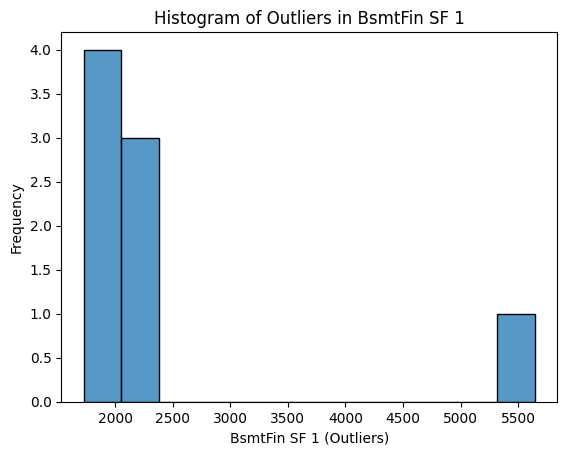


 
 ------------------- BsmtFin SF 2 -------------------
Outliers of BsmtFin SF 2 from IQR method:  length: 0  -  set()
before lower bound of BsmtFin SF 2 : length: 0  -  set()
after upper bound of BsmtFin SF 2 : length: 0  -  set()

 
 ------------------- Bsmt Unf SF -------------------
Outliers of Bsmt Unf SF from IQR method:  length: 16  -  {1728.0, 1824.0, 1795.0, 1765.0, 1704.0, 1800.0, 1706.0, 1802.0, 2121.0, 1869.0, 1774.0, 1935.0, 2153.0, 1777.0, 1905.0, 1969.0}
before lower bound of Bsmt Unf SF : length: 0  -  set()
after upper bound of Bsmt Unf SF : length: 16  -  {1728.0, 1824.0, 1795.0, 1765.0, 1704.0, 1800.0, 1706.0, 1802.0, 2121.0, 1869.0, 1774.0, 1935.0, 2153.0, 1777.0, 1905.0, 1969.0}


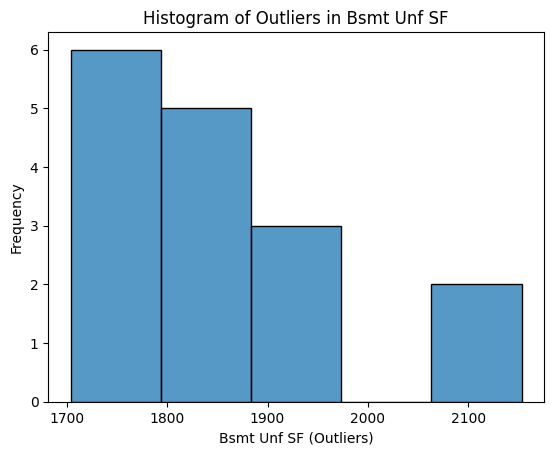


 
 ------------------- Total Bsmt SF -------------------
Outliers of Total Bsmt SF from IQR method:  length: 15  -  {3200.0, 2660.0, 2535.0, 2217.0, 2633.0, 2220.0, 2444.0, 2223.0, 2320.0, 2418.0, 2552.0, 2396.0, 2461.0, 6110.0, 2271.0}
before lower bound of Total Bsmt SF : length: 0  -  set()
after upper bound of Total Bsmt SF : length: 15  -  {3200.0, 2660.0, 2535.0, 2217.0, 2633.0, 2220.0, 2444.0, 2223.0, 2320.0, 2418.0, 2552.0, 2396.0, 2461.0, 6110.0, 2271.0}


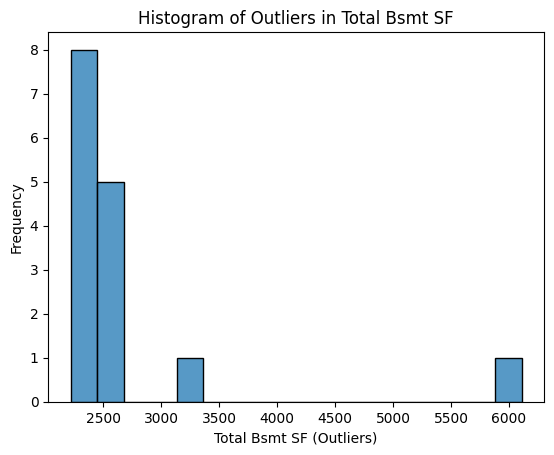


 
 ------------------- 1st Flr SF -------------------
Outliers of 1st Flr SF from IQR method:  length: 15  -  {2464, 2497, 2338, 2276, 2470, 2633, 2411, 2444, 3820, 2290, 2898, 4692, 2552, 2362, 3228}
before lower bound of 1st Flr SF : length: 0  -  set()
after upper bound of 1st Flr SF : length: 15  -  {2464, 2497, 2338, 2276, 2470, 2633, 2411, 2444, 3820, 2290, 2898, 4692, 2552, 2362, 3228}


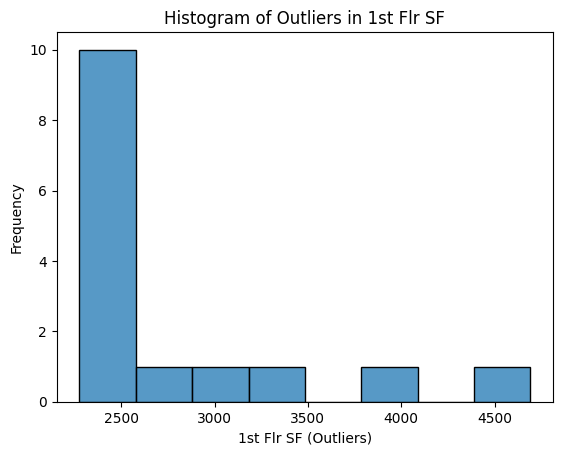


 
 ------------------- 2nd Flr SF -------------------
Outliers of 2nd Flr SF from IQR method:  length: 18  -  {1345, 1377, 1540, 167, 1479, 1611, 1420, 1357, 110, 1402, 1872, 2065, 1426, 182, 1721, 1370, 1818, 1407}
before lower bound of 2nd Flr SF : length: 3  -  {182, 110, 167}
after upper bound of 2nd Flr SF : length: 15  -  {1345, 1377, 1540, 1479, 1611, 1420, 1357, 1402, 1872, 2065, 1426, 1721, 1370, 1818, 1407}


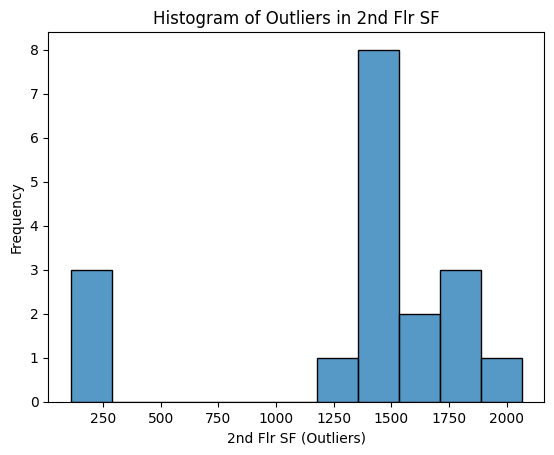


 
 ------------------- Low Qual Fin SF -------------------
Outliers of Low Qual Fin SF from IQR method:  length: 0  -  set()
before lower bound of Low Qual Fin SF : length: 0  -  set()
after upper bound of Low Qual Fin SF : length: 0  -  set()

 
 ------------------- Gr Liv Area -------------------
Outliers of Gr Liv Area from IQR method:  length: 25  -  {2944, 2690, 3078, 5642, 2956, 2840, 2713, 2715, 3228, 3493, 2872, 2748, 2758, 2898, 2775, 4316, 2786, 2790, 2792, 3820, 3447, 2810, 4476, 2814}
before lower bound of Gr Liv Area : length: 0  -  set()
after upper bound of Gr Liv Area : length: 25  -  {2944, 2690, 3078, 5642, 2956, 2840, 2713, 2715, 3228, 3493, 2872, 2748, 2758, 2898, 2775, 4316, 2786, 2790, 2792, 3820, 3447, 2810, 4476, 2814}


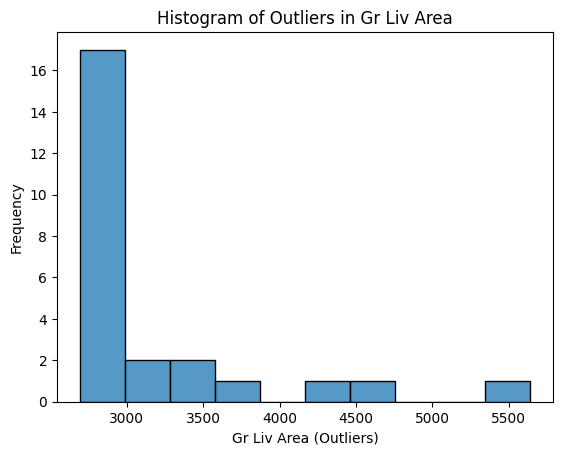


 
 ------------------- Bsmt Full Bath -------------------
Outliers of Bsmt Full Bath from IQR method:  length: 11  -  {2.0}
before lower bound of Bsmt Full Bath : length: 0  -  set()
after upper bound of Bsmt Full Bath : length: 11  -  {2.0}


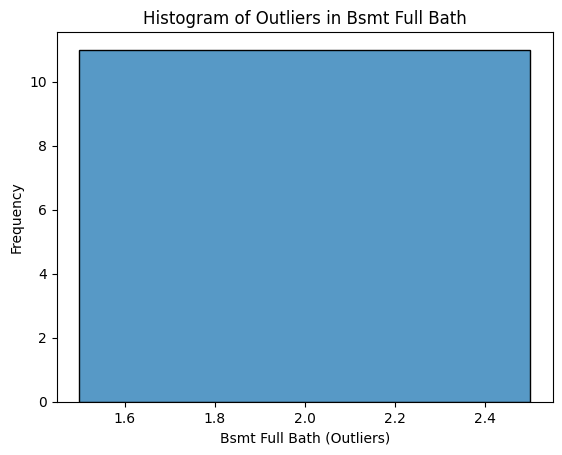


 
 ------------------- Bsmt Half Bath -------------------
Outliers of Bsmt Half Bath from IQR method:  length: 1  -  {2.0}
before lower bound of Bsmt Half Bath : length: 0  -  set()
after upper bound of Bsmt Half Bath : length: 1  -  {2.0}


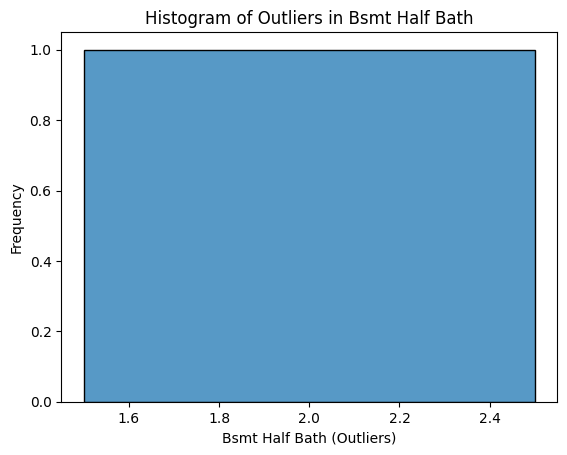


 
 ------------------- Full Bath -------------------
Outliers of Full Bath from IQR method:  length: 0  -  set()
before lower bound of Full Bath : length: 0  -  set()
after upper bound of Full Bath : length: 0  -  set()

 
 ------------------- Half Bath -------------------
Outliers of Half Bath from IQR method:  length: 11  -  {2}
before lower bound of Half Bath : length: 0  -  set()
after upper bound of Half Bath : length: 11  -  {2}


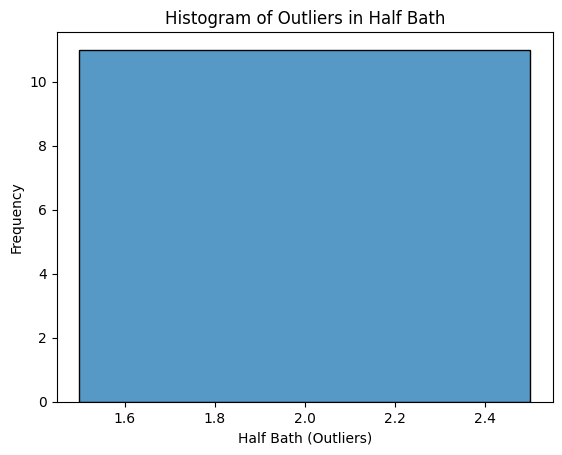


 
 ------------------- Bedroom AbvGr -------------------
Outliers of Bedroom AbvGr from IQR method:  length: 16  -  {5, 6}
before lower bound of Bedroom AbvGr : length: 0  -  set()
after upper bound of Bedroom AbvGr : length: 16  -  {5, 6}


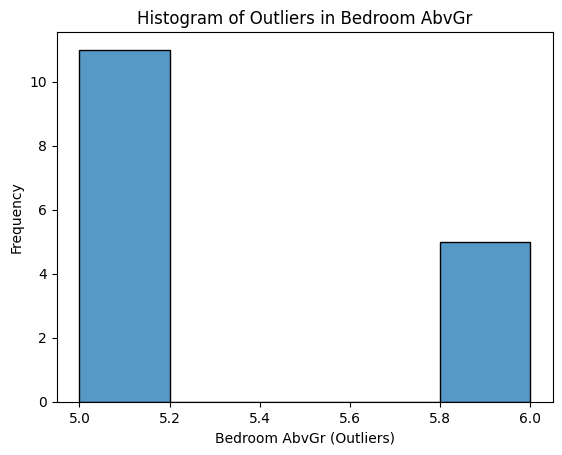


 
 ------------------- Kitchen AbvGr -------------------
Outliers of Kitchen AbvGr from IQR method:  length: 35  -  {2}
before lower bound of Kitchen AbvGr : length: 0  -  set()
after upper bound of Kitchen AbvGr : length: 35  -  {2}


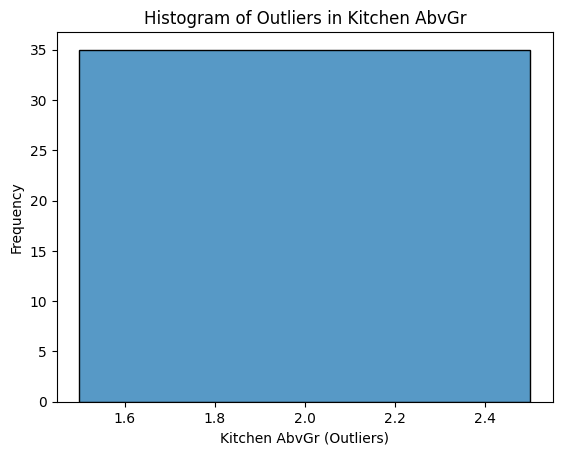


 
 ------------------- TotRms AbvGrd -------------------
Outliers of TotRms AbvGrd from IQR method:  length: 13  -  {11, 12}
before lower bound of TotRms AbvGrd : length: 0  -  set()
after upper bound of TotRms AbvGrd : length: 13  -  {11, 12}


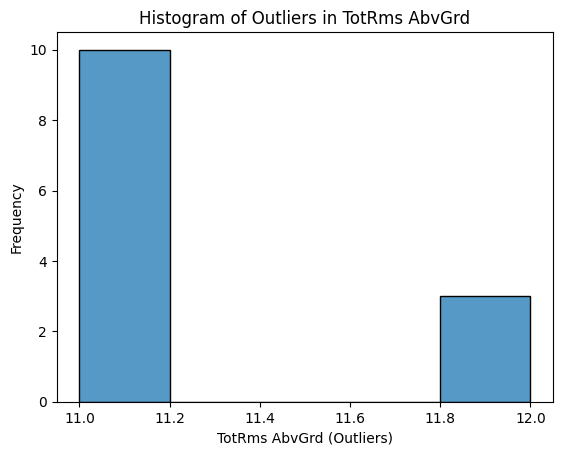


 
 ------------------- Fireplaces -------------------
Outliers of Fireplaces from IQR method:  length: 60  -  {2, 3}
before lower bound of Fireplaces : length: 0  -  set()
after upper bound of Fireplaces : length: 60  -  {2, 3}


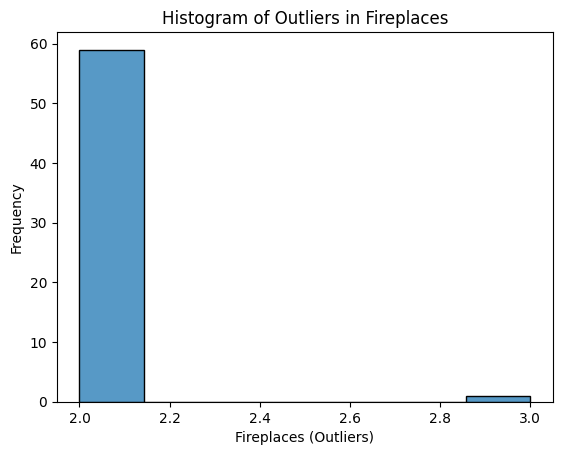


 
 ------------------- Garage Yr Blt -------------------
Outliers of Garage Yr Blt from IQR method:  length: 3  -  {1906.0, 1900.0, 1895.0}
before lower bound of Garage Yr Blt : length: 3  -  {1906.0, 1900.0, 1895.0}
after upper bound of Garage Yr Blt : length: 0  -  set()


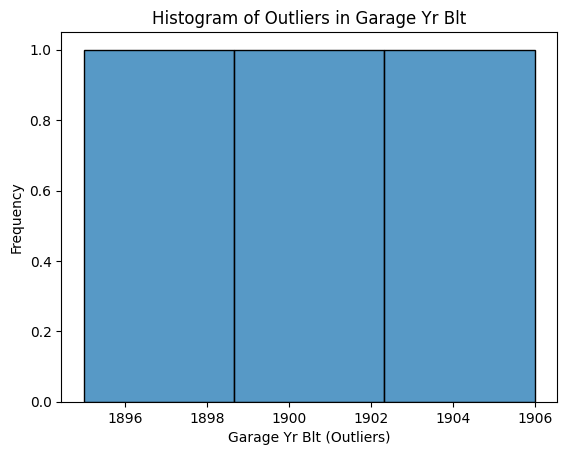


 
 ------------------- Garage Cars -------------------
Outliers of Garage Cars from IQR method:  length: 345  -  {1, 3, 4}
before lower bound of Garage Cars : length: 197  -  {1}
after upper bound of Garage Cars : length: 148  -  {3, 4}


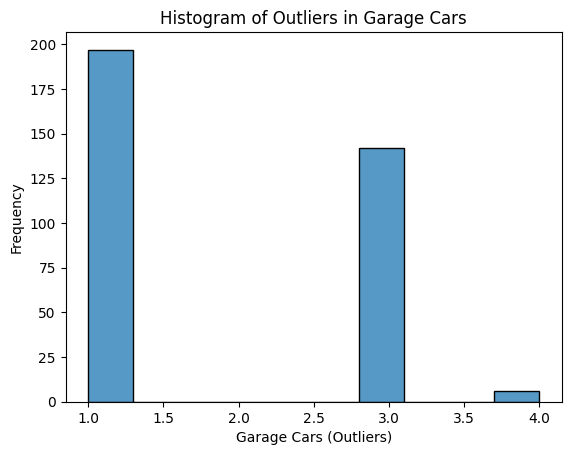


 
 ------------------- Garage Area -------------------
Outliers of Garage Area from IQR method:  length: 35  -  {1025, 905, 1418, 908, 912, 1040, 916, 1174, 924, 925, 1052, 928, 1314, 932, 933, 936, 938, 944, 947, 954, 1092, 1220, 1348, 1488, 1105, 1110, 983, 1248, 1003, 1014, 1150}
before lower bound of Garage Area : length: 0  -  set()
after upper bound of Garage Area : length: 35  -  {1025, 905, 1418, 908, 912, 1040, 916, 1174, 924, 925, 1052, 928, 1314, 932, 933, 936, 938, 944, 947, 954, 1092, 1220, 1348, 1488, 1105, 1110, 983, 1248, 1003, 1014, 1150}


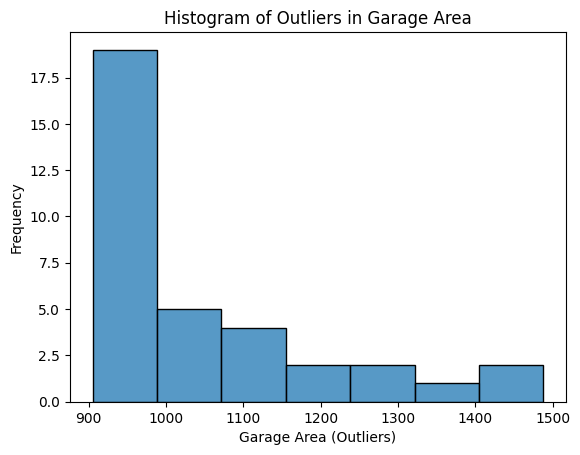


 
 ------------------- Wood Deck SF -------------------
Outliers of Wood Deck SF from IQR method:  length: 27  -  {385, 390, 400, 402, 403, 407, 409, 411, 414, 670, 418, 550, 424, 426, 428, 431, 455, 460, 467, 736, 486, 490, 495, 500, 382, 511}
before lower bound of Wood Deck SF : length: 0  -  set()
after upper bound of Wood Deck SF : length: 27  -  {385, 390, 400, 402, 403, 407, 409, 411, 414, 670, 418, 550, 424, 426, 428, 431, 455, 460, 467, 736, 486, 490, 495, 500, 382, 511}


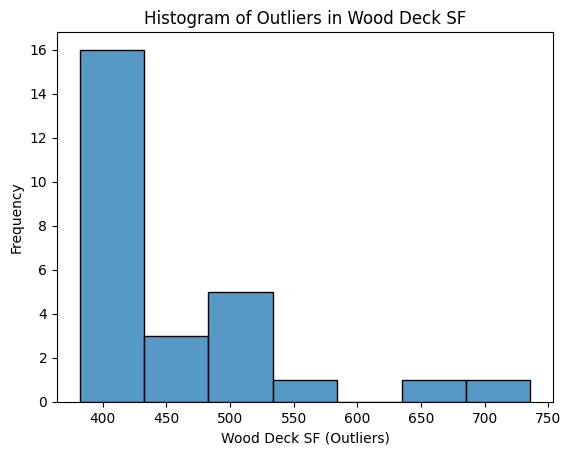


 
 ------------------- Open Porch SF -------------------
Outliers of Open Porch SF from IQR method:  length: 31  -  {256, 265, 276, 282, 285, 291, 292, 547, 299, 304, 312, 217, 224, 228, 230, 235, 236, 364, 238, 365, 240, 241, 368, 243, 372, 502, 251}
before lower bound of Open Porch SF : length: 0  -  set()
after upper bound of Open Porch SF : length: 31  -  {256, 265, 276, 282, 285, 291, 292, 547, 299, 304, 312, 217, 224, 228, 230, 235, 236, 364, 238, 365, 240, 241, 368, 243, 372, 502, 251}


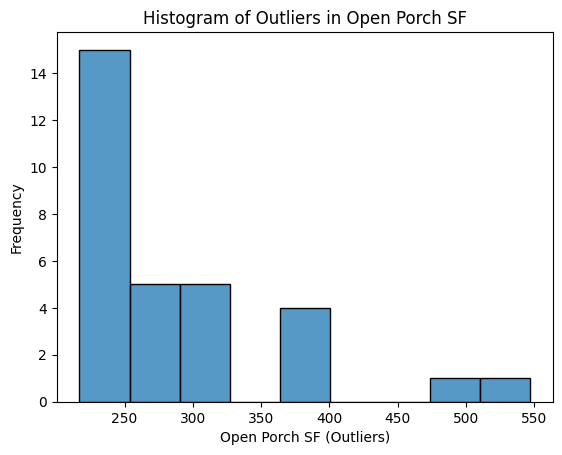


 
 ------------------- Enclosed Porch -------------------
Outliers of Enclosed Porch from IQR method:  length: 0  -  set()
before lower bound of Enclosed Porch : length: 0  -  set()
after upper bound of Enclosed Porch : length: 0  -  set()

 
 ------------------- 3Ssn Porch -------------------
Outliers of 3Ssn Porch from IQR method:  length: 1  -  {407}
before lower bound of 3Ssn Porch : length: 0  -  set()
after upper bound of 3Ssn Porch : length: 1  -  {407}


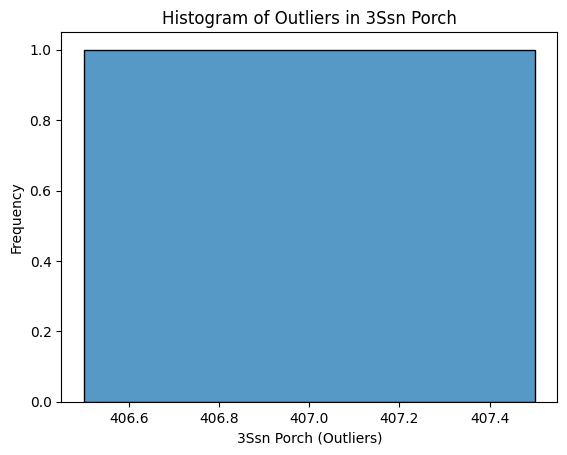


 
 ------------------- Screen Porch -------------------
Outliers of Screen Porch from IQR method:  length: 3  -  {480, 322, 576}
before lower bound of Screen Porch : length: 0  -  set()
after upper bound of Screen Porch : length: 3  -  {480, 322, 576}


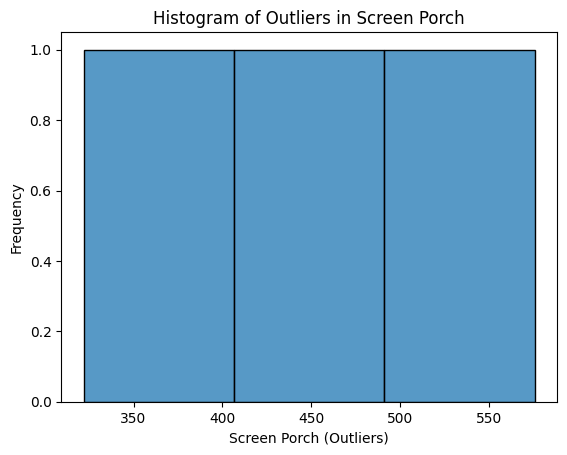


 
 ------------------- Pool Area -------------------
Outliers of Pool Area from IQR method:  length: 1  -  {144}
before lower bound of Pool Area : length: 1  -  {144}
after upper bound of Pool Area : length: 0  -  set()


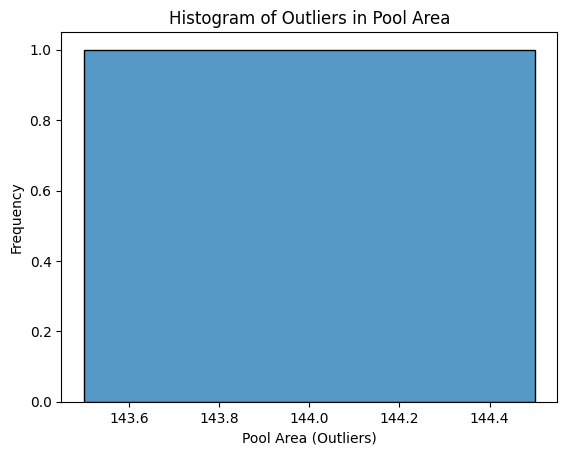


 
 ------------------- Misc Val -------------------
Outliers of Misc Val from IQR method:  length: 5  -  {6500, 8300, 15500, 4500, 3000}
before lower bound of Misc Val : length: 0  -  set()
after upper bound of Misc Val : length: 5  -  {6500, 8300, 15500, 4500, 3000}


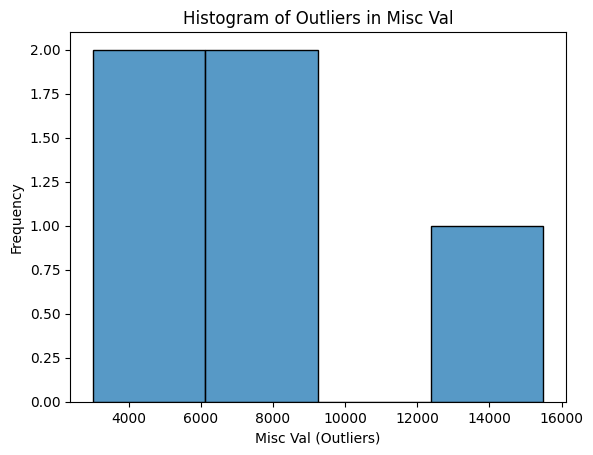


 
 ------------------- Mo Sold -------------------
Outliers of Mo Sold from IQR method:  length: 0  -  set()
before lower bound of Mo Sold : length: 0  -  set()
after upper bound of Mo Sold : length: 0  -  set()

 
 ------------------- Yr Sold -------------------
Outliers of Yr Sold from IQR method:  length: 0  -  set()
before lower bound of Yr Sold : length: 0  -  set()
after upper bound of Yr Sold : length: 0  -  set()

 
 ------------------- SalePrice -------------------
Outliers of SalePrice from IQR method:  length: 46  -  {421250, 373000, 395000, 410000, 426000, 372500, 370967, 383000, 395039, 372000, 745000, 430000, 372402, 392500, 446261, 387000, 755000, 419005, 367294, 392000, 440000, 415298, 466500, 381000, 441929, 370000, 418000, 377426, 450000, 412500, 475000, 455000, 615000, 417500, 479069, 380000, 460000, 492000, 500067, 591587, 385000, 390000, 384500, 379000, 394617}
before lower bound of SalePrice : length: 0  -  set()
after upper bound of SalePrice : length: 46  -  {4

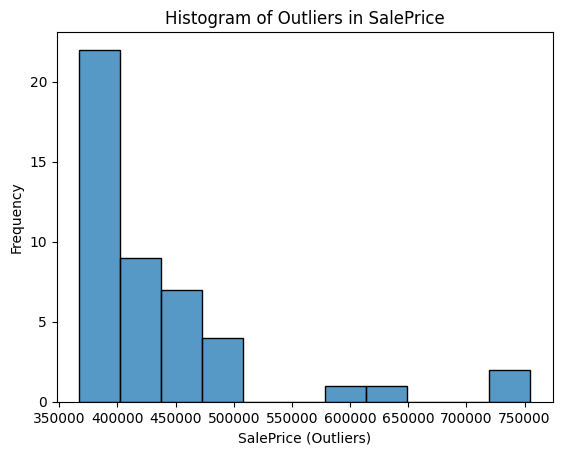

In [ ]:
detect_outliers_iqr_exclude_zeros(df,continous_feat)

In [ ]:
out_feat = ['MS SubClass', 'Lot Frontage', 'Lot Area',
       'Overall Cond', 'Year Built', 'Mas Vnr Area','BsmtFin SF 1',
        'BsmtFin SF 2', 'Total Bsmt SF',
       '1st Flr SF', '2nd Flr SF', 'Gr Liv Area',
       'Bsmt Full Bath', 'Bsmt Half Bath', 'Half Bath',
       'Kitchen AbvGr', 'TotRms AbvGrd', 'Fireplaces',
       'Garage Yr Blt',  'Garage Area', 'Wood Deck SF',
       'Open Porch SF', 'Screen Porch',
       'Pool Area', 'Misc Val']
outliers_handler_exclude_zeros(df, continous_feat)

,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,120,RL,45.0,6264.00,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,5,1997,1997,Gable,CompShg,CemntBd,CmentBd,no mas vnr,44.0,Gd,TA,PConc,Ex,TA,Mn,GLQ,656.0,Unf,48.4,1008.0,1664.0,GasA,Ex,Y,SBrkr,1682.00,416.0,122.4,1682.0,1.0,1.0,1,1,2,1,Gd,6,Min1,1,TA,Attchd,1997.00,Fin,2,528.0,TA,TA,Y,62.6,21.15,38.4,108.0,94.65,194.40,No Pool,No Fence,No Misc Feature,400.0,7,2008,WD,Normal,247900.0
1,120,RL,41.0,5395.00,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1993,1993,Gable,CompShg,HdBoard,HdBoard,no mas vnr,44.0,Gd,TA,PConc,Gd,TA,No,GLQ,733.0,Unf,48.4,604.0,1337.0,GasA,Gd,Y,SBrkr,1337.00,416.0,122.4,1337.0,1.0,1.0,2,1,2,1,Gd,5,Typ,1,TA,Attchd,1993.00,RFn,2,462.0,TA,TA,Y,96.0,21.15,70.0,168.0,94.65,194.40,No Pool,No Fence,No Misc Feature,400.0,10,2008,WD,Normal,180000.0
2,120,RL,39.0,5070.00,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,no mas vnr,44.0,Gd,TA,PConc,Gd,TA,Mn,Unf,56.0,Unf,48.4,1280.0,1280.0,GasA,Ex,Y,SBrkr,1280.00,416.0,122.4,1280.0,1.0,1.0,2,1,2,1,Gd,5,Typ,1,No Fireplace,Attchd,1992.00,RFn,2,506.0,TA,TA,Y,62.6,82.00,38.4,108.0,144.00,194.40,No Pool,No Fence,No Misc Feature,400.0,8,2008,WD,Normal,180000.0
3,60,RL,100.0,10839.00,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,44.0,TA,TA,PConc,Gd,TA,No,Unf,56.0,Unf,48.4,926.0,926.0,GasA,Ex,Y,SBrkr,926.00,678.0,122.4,1604.0,1.0,1.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1997.00,Fin,2,470.0,TA,TA,Y,62.6,36.00,38.4,108.0,94.65,194.40,No Pool,No Fence,No Misc Feature,400.0,7,2008,WD,Normal,181000.0
4,60,RL,73.0,11184.00,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,44.0,TA,TA,PConc,Gd,TA,No,Unf,56.0,Unf,48.4,932.0,932.0,GasA,Gd,Y,SBrkr,932.00,701.0,122.4,1633.0,1.0,1.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1998.00,Fin,2,460.0,TA,TA,Y,62.6,39.00,38.4,108.0,94.65,194.40,No Pool,No Fence,No Misc Feature,400.0,4,2008,WD,Family,183000.0
5,60,RL,31.3,8000.00,Pave,No alley access,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1995,1996,Gable,CompShg,HdBoard,HdBoard,no mas vnr,44.0,TA,TA,PConc,Gd,TA,No,GLQ,219.0,Unf,48.4,554.0,773.0,GasA,Gd,Y,SBrkr,773.00,885.0,122.4,1658.0,1.0,1.0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1995.00,Fin,2,431.0,TA,TA,Y,224.0,84.00,38.4,108.0,94.65,194.40,No Pool,No Fence,No Misc Feature,400.0,6,2008,WD,Normal,188000.0
6,60,RL,31.3,10832.00,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,1994,1996,Gable,CompShg,MetalSd,MetalSd,no mas vnr,44.0,Gd,TA,PConc,Gd,TA,No,Unf,56.0,Unf,48.4,712.0,712.0,GasA,Ex,Y,SBrkr,1086.00,809.0,122.4,1895.0,1.0,1.0,2,1,3,1,Gd,7,Typ,1,TA,Attchd,1994.00,Fin,2,409.0,TA,TA,Y,143.0,46.00,38.4,108.0,94.65,194.40,No Pool,No Fence,Shed,500.0,10,2008,WD,Normal,194500.0
7,60,RL,31.3,14067.00,Pave,No alley access,Reg,Lvl,AllPub,FR3,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1991,1991,Gable,Com

In [ ]:
detect_box_voilin_hist_exclude_zeros(df,continous_feat)


features that are highly positively skewed (skewness >1) are  ['MS SubClass', 'Lot Area', 'Mas Vnr Area', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Total Bsmt SF', '1st Flr SF', 'Low Qual Fin SF', 'Gr Liv Area', 'Bsmt Half Bath', 'Kitchen AbvGr', 'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch', 'Pool Area', 'Misc Val', 'SalePrice']
features that are highly negatively skewed (skewness <-1) are  ['Garage Yr Blt']
features that are moderately positively skewed (0.5 < skewness < 1 ) are  ['Lot Frontage', 'Overall Cond', 'Bsmt Unf SF', '2nd Flr SF', 'Bsmt Full Bath', 'Half Bath', 'TotRms AbvGrd', 'Fireplaces']
features that are moderately negatively skewed (-0.5 < skewness < -1 ) are  []
features that are normally distributed (-0.5 < skewness < 0.5 ) are ['Overall Qual', 'Full Bath', 'Bedroom AbvGr', 'Garage Cars', 'Garage Area', 'Mo Sold']



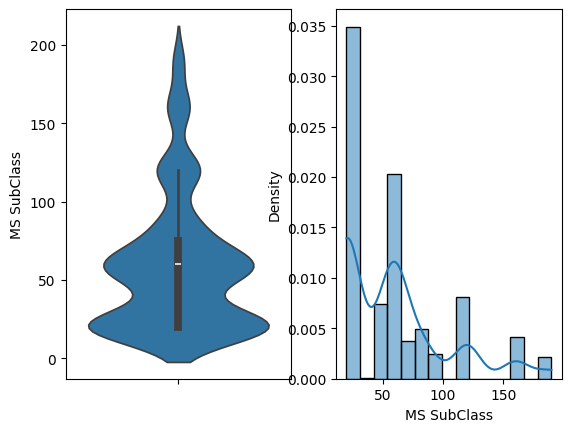

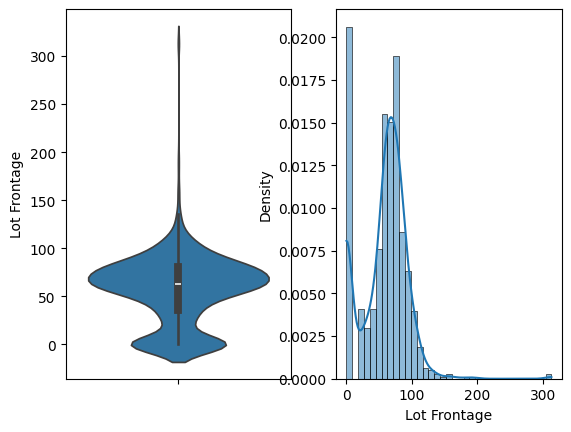

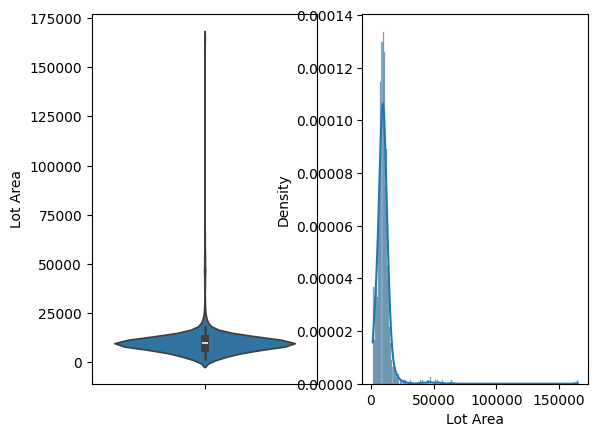

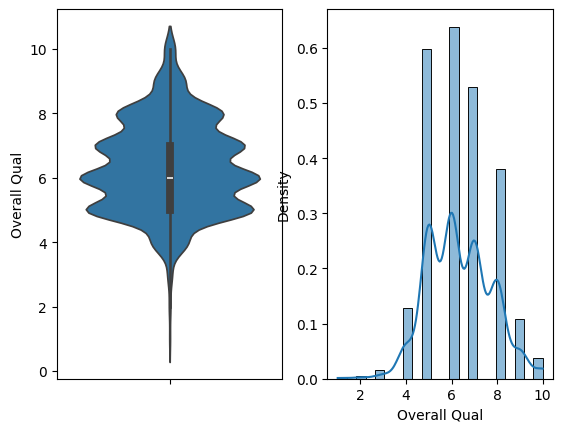

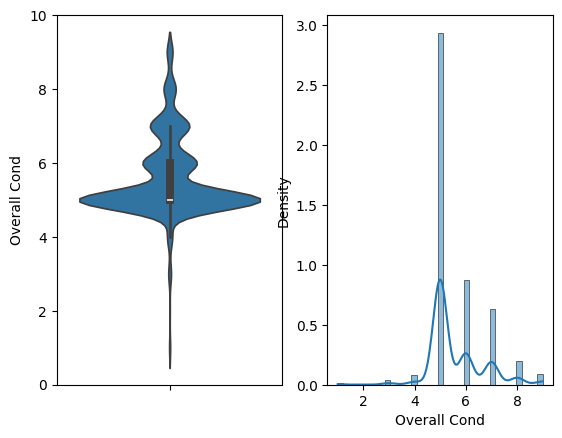

...

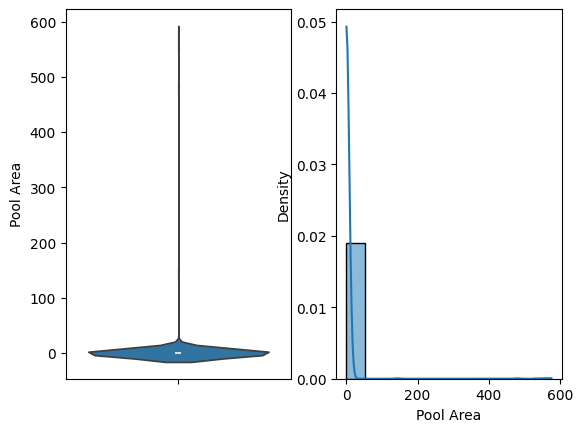

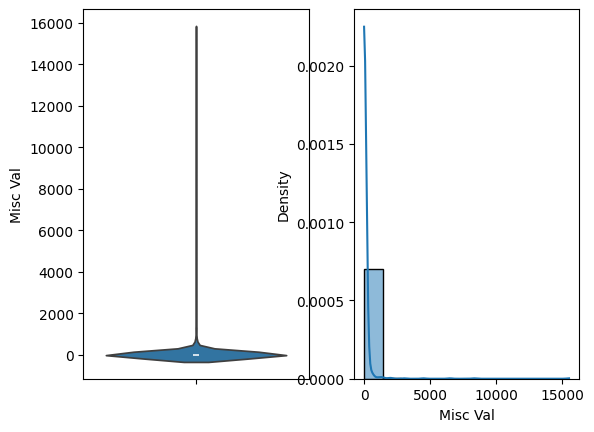

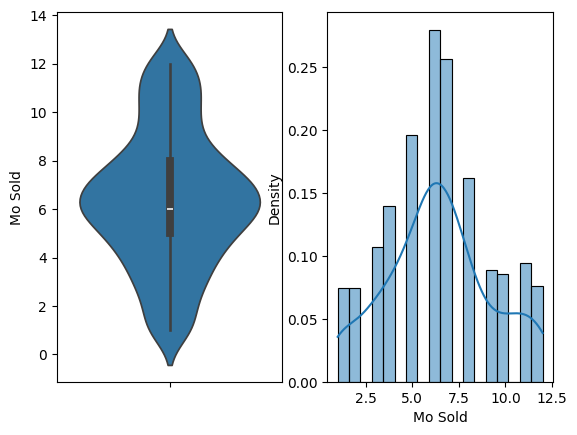

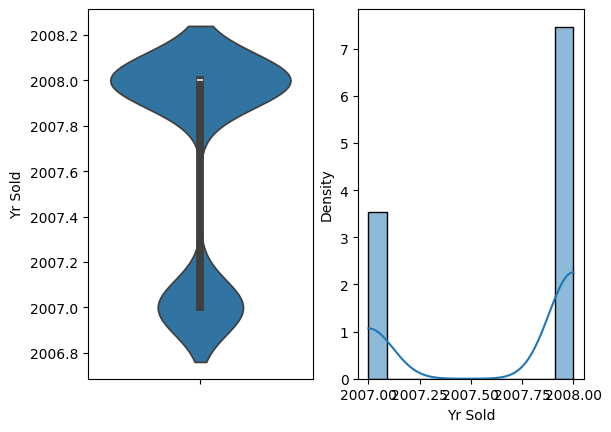

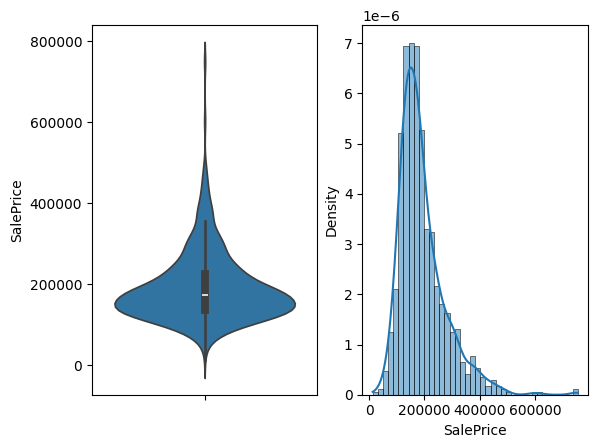

transformation  ['MS SubClass', 'Lot Area', 'Mas Vnr Area', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Total Bsmt SF', '1st Flr SF', 'Low Qual Fin SF', 'Gr Liv Area', 'Bsmt Half Bath', 'Kitchen AbvGr', 'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch', 'Pool Area', 'Misc Val', 'SalePrice', 'Garage Yr Blt', 'Lot Frontage', 'Overall Cond', 'Bsmt Unf SF', '2nd Flr SF', 'Bsmt Full Bath', 'Half Bath', 'TotRms AbvGrd', 'Fireplaces']  to change the distribution


['MS SubClass',
 'Lot Area',
 'Mas Vnr Area',
 'BsmtFin SF 1',
 'BsmtFin SF 2',
 'Total Bsmt SF',
 '1st Flr SF',
 'Low Qual Fin SF',
 'Gr Liv Area',
 'Bsmt Half Bath',
 'Kitchen AbvGr',
 'Wood Deck SF',
 'Open Porch SF',
 'Enclosed Porch',
 '3Ssn Porch',
 'Screen Porch',
 'Pool Area',
 'Misc Val',
 'SalePrice',
 'Garage Yr Blt',
 'Lot Frontage',
 'Overall Cond',
 'Bsmt Unf SF',
 '2nd Flr SF',
 'Bsmt Full Bath',
 'Half Bath',
 'TotRms AbvGrd',
 'Fireplaces']

In [ ]:
detect_distriution(df)

log transformation -->  ['MS SubClass', 'Lot Area', 'Mas Vnr Area', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Total Bsmt SF', '1st Flr SF', 'Low Qual Fin SF', 'Gr Liv Area', 'Bsmt Half Bath', 'Kitchen AbvGr', 'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch', 'Pool Area', 'Misc Val', 'SalePrice']


Features that are highly positively skewed (skewness > 1) are: ['MS SubClass', 'Overall Cond', 'Mas Vnr Area', 'BsmtFin SF 2', '2nd Flr SF', 'Low Qual Fin SF', 'Fireplaces', 'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch', 'Pool Area', 'Misc Val']
Features that are highly negatively skewed (skewness <-1) are: []
Features that are moderately positively skewed (0.5 < skewness < 1) are: ['BsmtFin SF 1', 'Bsmt Unf SF', 'Gr Liv Area', 'Garage Area', 'SalePrice']
Features that are moderately negatively skewed (-0.5 < skewness < -1) are: []
Features that are normally distributed (-0.5 < skewness < 0.5) are: ['Lot Frontage', 'Lot Area', 'Overall Qual', 'Year Built', 'Year Remod/Add', 'Total Bsmt SF', '1st Flr SF', 'Bsmt Full Bath', 'Bsmt Half Bath', 'Full Bath', 'Half Bath', 'Bedroom AbvGr', 'Kitchen AbvGr', 'TotRms AbvGrd', 'Garage Yr Blt', 'Garage Cars', 'Mo Sold', 'Yr Sold']



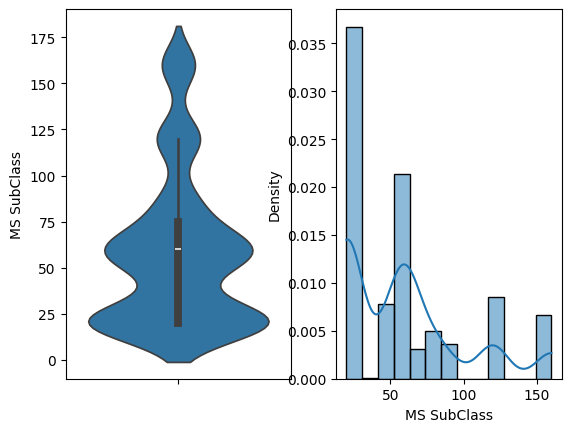

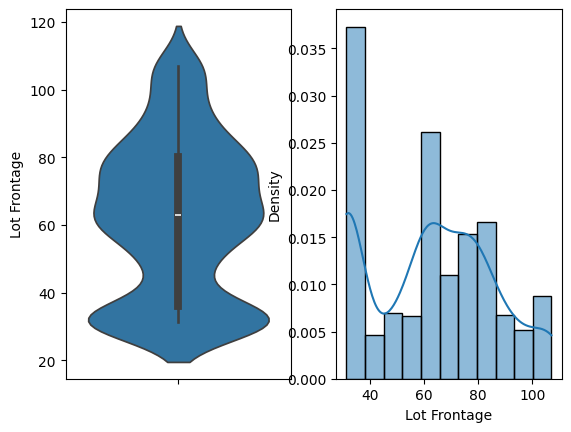

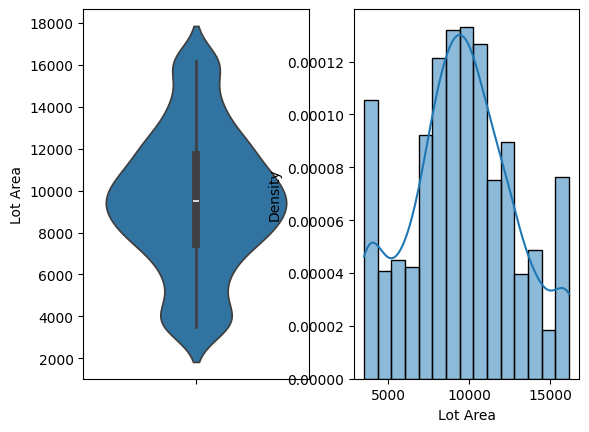

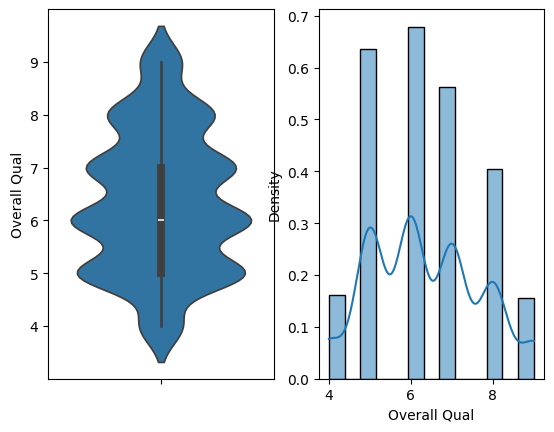

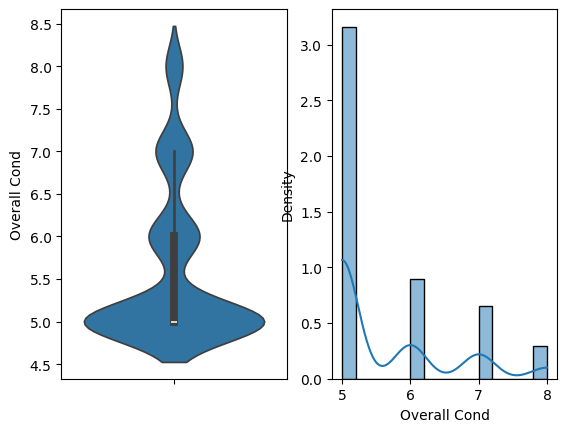

...

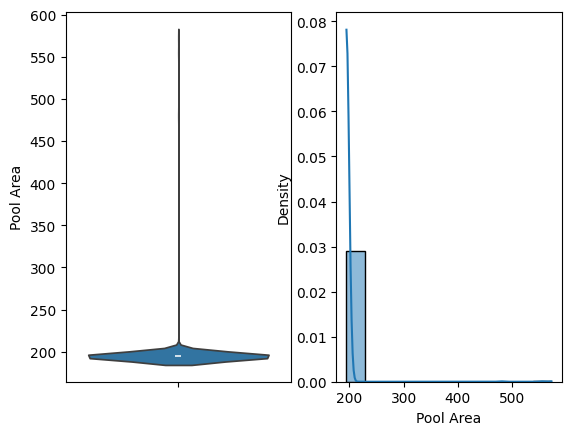

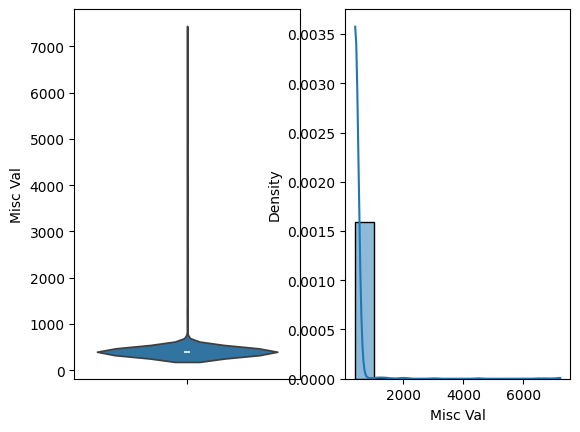

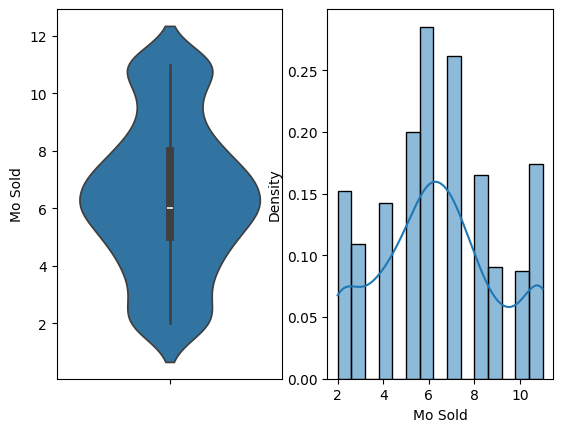

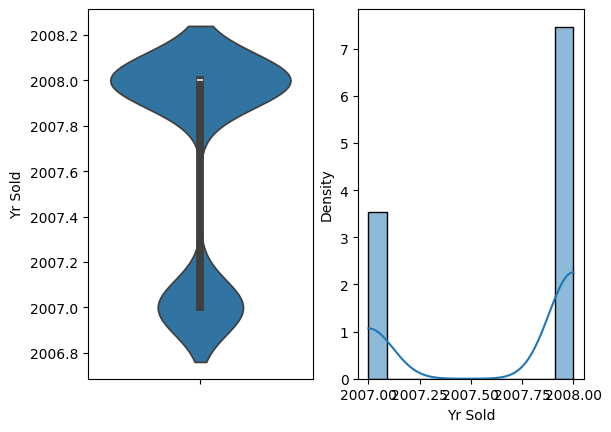

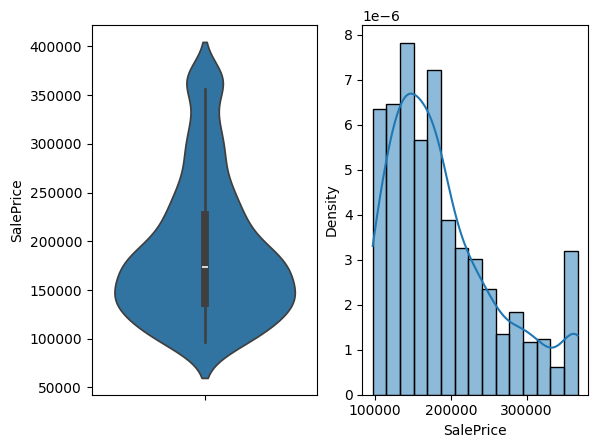

Features requiring transformation (not normally distributed): ['MS SubClass', 'Overall Cond', 'Mas Vnr Area', 'BsmtFin SF 2', '2nd Flr SF', 'Low Qual Fin SF', 'Fireplaces', 'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch', 'Screen Porch', 'Pool Area', 'Misc Val', 'BsmtFin SF 1', 'Bsmt Unf SF', 'Gr Liv Area', 'Garage Area', 'SalePrice']


['MS SubClass',
 'Overall Cond',
 'Mas Vnr Area',
 'BsmtFin SF 2',
 '2nd Flr SF',
 'Low Qual Fin SF',
 'Fireplaces',
 'Wood Deck SF',
 'Open Porch SF',
 'Enclosed Porch',
 '3Ssn Porch',
 'Screen Porch',
 'Pool Area',
 'Misc Val',
 'BsmtFin SF 1',
 'Bsmt Unf SF',
 'Gr Liv Area',
 'Garage Area',
 'SalePrice']

In [ ]:
continous_feat = ['Lot Frontage', 'Lot Area','Mas Vnr Area','BsmtFin SF 1','BsmtFin SF 2','Bsmt Unf SF','Total Bsmt SF','1st Flr SF','2nd Flr SF','Low Qual Fin SF', 'Gr Liv Area','Garage Area','Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3-Ssn Porch', 'Screen Porch' , 'Pool Area', 'Misc Val']
detect_distribution_exclude_zeros(df,continous_feat)

In [ ]:
df.describe()

,MS SubClass,Lot Frontage,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Mas Vnr Area,BsmtFin SF 1,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,TotRms AbvGrd,Fireplaces,Garage Yr Blt,Garage Cars,Garage Area,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,SalePrice
count,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000,900.000000
mean,59.411111,57.153333,10098.395556,6.340000,5.583333,1976.127778,1987.368889,121.622222,454.904444,43.110000,589.633333,1087.647778,1184.108889,349.820000,2.714444,1536.643333,0.428889,0.064444,1.634444,0.410000,2.861111,1.038889,6.493333,0.604444,1884.998889,1.856667,494.427778,93.808889,52.184444,17.794444,2.502222,16.016667,1.950000,66.100000,6.397778,2007.678889,192203.651111
std,43.327117,35.881259,7542.998413,1.396786,1.066608,29.109098,19.795493,197.585164,486.088881,151.196202,448.338920,467.723445,415.805801,439.844326,35.055773,523.949586,0.519314,0.250166,0.534392,0.516373,0.804353,0.193438,1.542487,0.614238,428.242567,0.757983,220.833672,116.215591,69.087291,52.406376,24.387970,57.849242,31.420128,666.824036,2.787944,0.467163,85313.945606
min,20.000000,0.000000,1477.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,407.000000,0.000000,0.000000,407.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2007.000000,13100.000000
25%,20.000000,36.000000,7466.500000,5.000000,5.000000,1959.000000,1971.000000,0.000000,0.000000,0.000000,249.500000,809.500000,882.000000,0.000000,0.000000,1159.750000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1962.000000,1.000000,369.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,136375.000000
50%,60.000000,63.000000,9522.500000,6.000000,5.000000,1978.000000,1996.000000,0.000000,372.000000,0.000000,486.500000,1032.000000,1117.500000,0.000000,0.000000,1479.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1985.000000,2.000000,484.000000,26.500000,32.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,174000.000000
75%,75.000000,80.000000,11695.500000,7.000000,6.000000,2003.000000,2004.000000,196.250000,767.500000,0.000000,828.750000,1352.000000,1423.250000,732.750000,0.000000,1771.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2003.000000,2.000000,588.000000,168.000000,75.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2008.000000,226712.500000
max,190.000000,313.000000,164660.000000,10.000000,9.000000,2008.000000,2008.000000,1600.000000,5644.000000,1080.000000,2153.000000,6110.000000,4692.000000,2065.000000,697.000000,5642.000000,2.000000,2.000000,3.000000,2.000000,6.000000,2.000000,12.000000,3.000000,2008.000000,4.000000,1488.000000,736.000000,547.000000,301.000000,407.000000,576.000000,576.000000,15500.000000,12.000000,2008.000000,755000.000000



Features that are highly positively skewed (skewness > 1) are: ['Lot Frontage', 'Lot Area', 'Mas Vnr Area', 'BsmtFin SF 1', 'Total Bsmt SF', '1st Flr SF', 'Gr Liv Area', 'Garage Area', 'Wood Deck SF', 'Open Porch SF', '3Ssn Porch', 'Screen Porch', 'Misc Val']
Features that are highly negatively skewed (skewness <-1) are: ['Pool Area']
Features that are moderately positively skewed (0.5 < skewness < 1) are: ['BsmtFin SF 2', 'Bsmt Unf SF', '2nd Flr SF', 'Low Qual Fin SF']
Features that are moderately negatively skewed (-0.5 < skewness < -1) are: []
Features that are normally distributed (-0.5 < skewness < 0.5) are: ['Enclosed Porch']



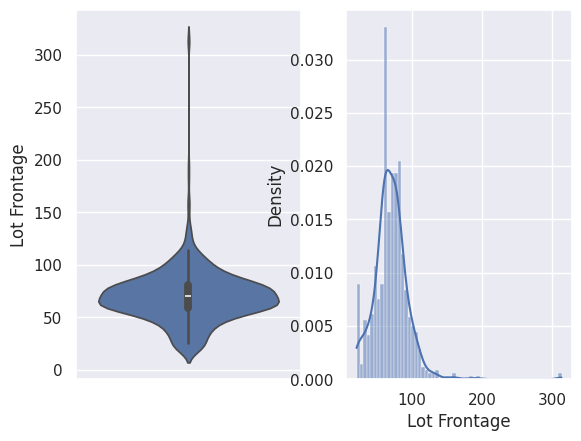

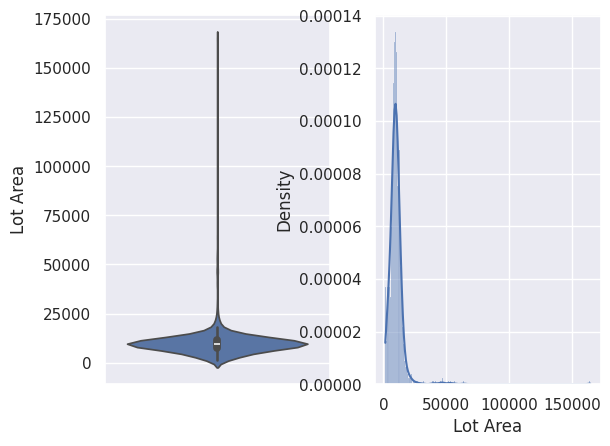

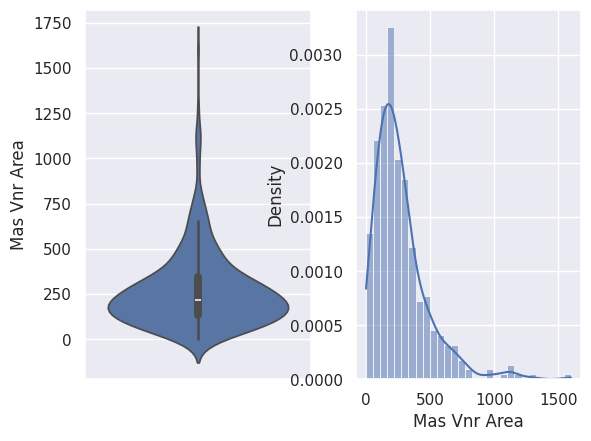

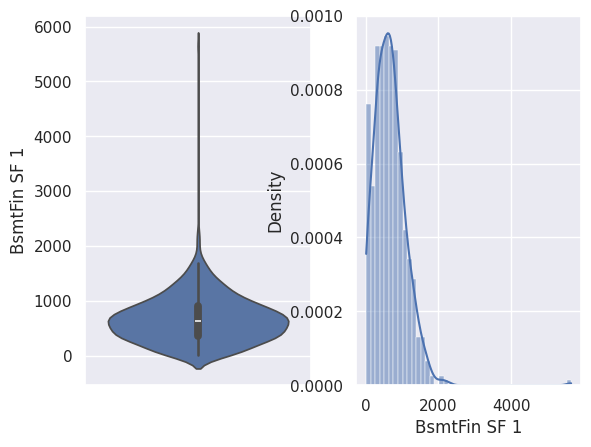

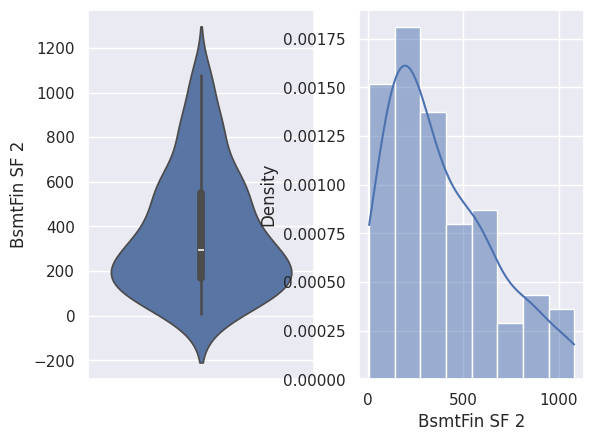

...

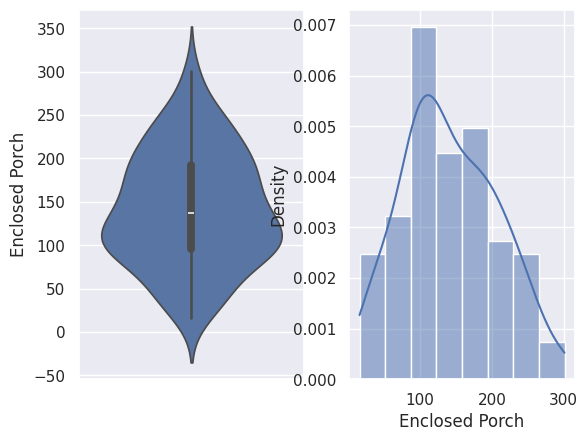

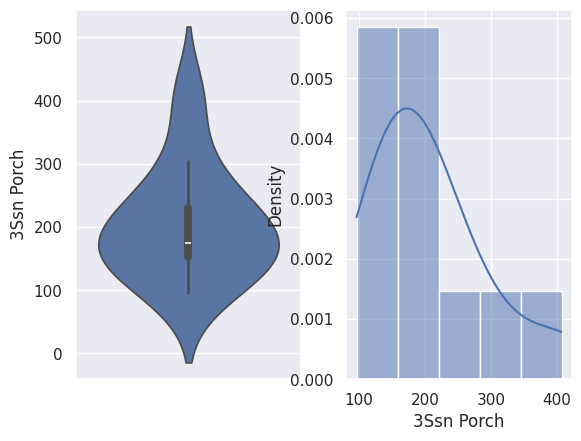

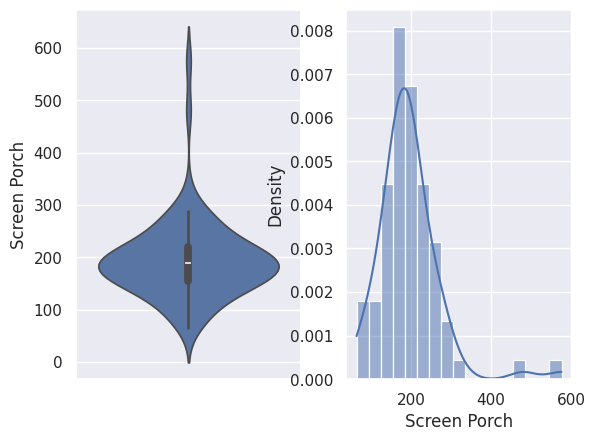

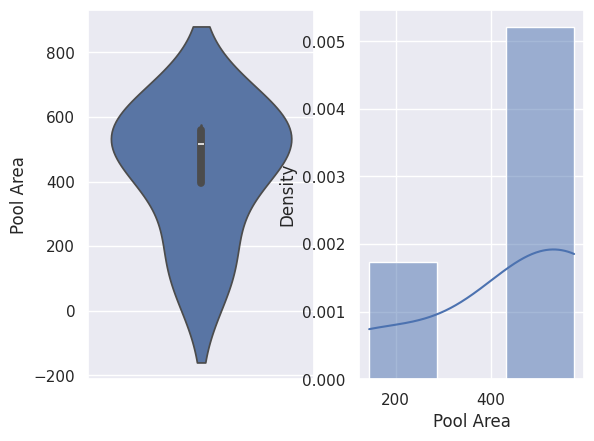

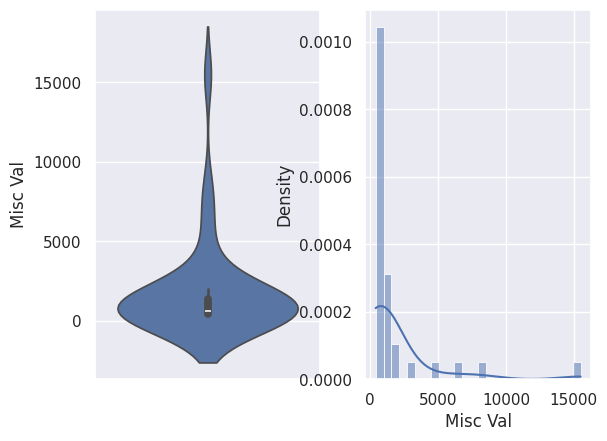

Features requiring transformation (not normally distributed): ['Lot Frontage', 'Lot Area', 'Mas Vnr Area', 'BsmtFin SF 1', 'Total Bsmt SF', '1st Flr SF', 'Gr Liv Area', 'Garage Area', 'Wood Deck SF', 'Open Porch SF', '3Ssn Porch', 'Screen Porch', 'Misc Val', 'Pool Area', 'BsmtFin SF 2', 'Bsmt Unf SF', '2nd Flr SF', 'Low Qual Fin SF']


['Lot Frontage',
 'Lot Area',
 'Mas Vnr Area',
 'BsmtFin SF 1',
 'Total Bsmt SF',
 '1st Flr SF',
 'Gr Liv Area',
 'Garage Area',
 'Wood Deck SF',
 'Open Porch SF',
 '3Ssn Porch',
 'Screen Porch',
 'Misc Val',
 'Pool Area',
 'BsmtFin SF 2',
 'Bsmt Unf SF',
 '2nd Flr SF',
 'Low Qual Fin SF']

In [ ]:
detect_distribution_exclude_zeros(df,continous_feat)

mean =  1884.9988888888888  std =  428.2425671602705


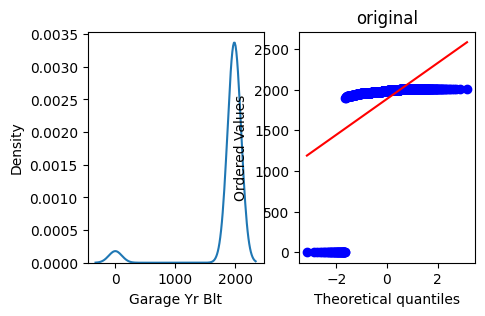

-4.170406840453792 

mean =  -inf  std =  nan


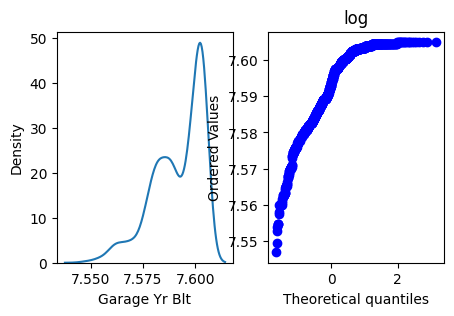

Garage Yr Blt   NaN
dtype: float64 

mean =  inf  std =  nan


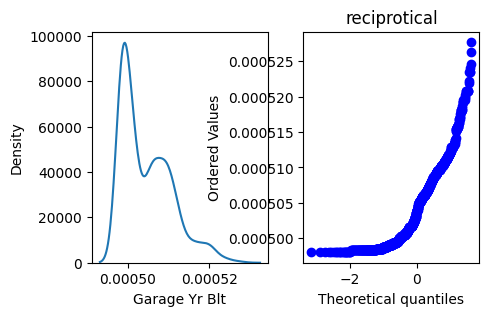

Garage Yr Blt   NaN
dtype: float64 

mean =  42.34120395094222  std =  9.608533655341631


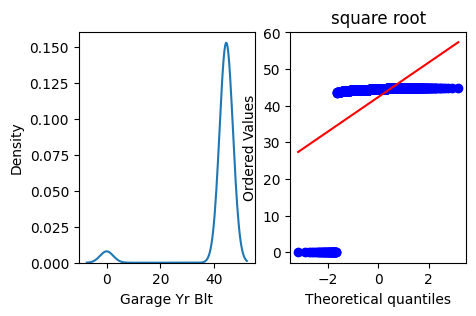

Garage Yr Blt   -4.185789
dtype: float64 

mean =  531.8551473802722  std =  120.77447986251525


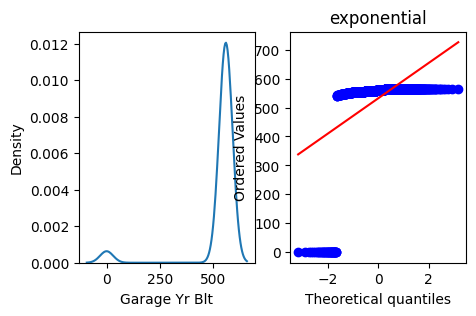

Garage Yr Blt   -4.176639
dtype: float64 



In [ ]:
normality(df,'Garage Yr Blt')

In [ ]:
no_missing_df = df.copy()

In [ ]:
no_missing_df

,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,120,RL,45.0,6264,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,5,1997,1997,Gable,CompShg,CemntBd,CmentBd,no mas vnr,0.0,Gd,TA,PConc,Ex,TA,Mn,GLQ,656.0,Unf,0.0,1008.0,1664.0,GasA,Ex,Y,SBrkr,1682,0,0,1682,1.0,0.0,1,1,1,1,Gd,6,Min1,1,TA,Attchd,1997.0,Fin,2,528,TA,TA,Y,0,0,0,0,0,0,No Pool,No Fence,No Misc Feature,0,7,2008,WD,Normal,247900
1,120,RL,41.0,5395,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1993,1993,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,733.0,Unf,0.0,604.0,1337.0,GasA,Gd,Y,SBrkr,1337,0,0,1337,1.0,0.0,2,0,2,1,Gd,5,Typ,1,TA,Attchd,1993.0,RFn,2,462,TA,TA,Y,96,0,70,168,0,0,No Pool,No Fence,No Misc Feature,0,10,2008,WD,Normal,180000
2,120,RL,39.0,5070,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,1280.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1992.0,RFn,2,506,TA,TA,Y,0,82,0,0,144,0,No Pool,No Fence,No Misc Feature,0,8,2008,WD,Normal,180000
3,60,RL,100.0,10839,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,926.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1997.0,Fin,2,470,TA,TA,Y,0,36,0,0,0,0,No Pool,No Fence,No Misc Feature,0,7,2008,WD,Normal,181000
4,60,RL,73.0,11184,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,932.0,932.0,GasA,Gd,Y,SBrkr,932,701,0,1633,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1998.0,Fin,2,460,TA,TA,Y,0,39,0,0,0,0,No Pool,No Fence,No Misc Feature,0,4,2008,WD,Family,183000
5,60,RL,0.0,8000,Pave,No alley access,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1995,1996,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,GLQ,219.0,Unf,0.0,554.0,773.0,GasA,Gd,Y,SBrkr,773,885,0,1658,1.0,0.0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1995.0,Fin,2,431,TA,TA,Y,224,84,0,0,0,0,No Pool,No Fence,No Misc Feature,0,6,2008,WD,Normal,188000
6,60,RL,0.0,10832,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,1994,1996,Gable,CompShg,MetalSd,MetalSd,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,712.0,712.0,GasA,Ex,Y,SBrkr,1086,809,0,1895,0.0,0.0,2,1,3,1,Gd,7,Typ,1,TA,Attchd,1994.0,Fin,2,409,TA,TA,Y,143,46,0,0,0,0,No Pool,No Fence,Shed,500,10,2008,WD,Normal,194500
7,60,RL,0.0,14067,Pave,No alley access,Reg,Lvl,AllPub,FR3,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1991,1991,Gable,CompShg,HdBoard,HdBoard,BrkFace,194.0,TA,TA,PConc,Gd,TA,No,ALQ,504.0,Unf,0.0,332.0,836.0,GasA,Gd,Y,SBrkr,851,858,0,1709,1.0,0.0,2,1,3,1,Gd,7,Typ,0,No Fireplace,Attchd,1991.0,Fin,2,416,TA,TA,Y,0,40,0,0,0,0,No Pool,GdPrv,No Misc Feature,0,9,2008,WD,Normal,185000
8,120,RL,40.0,4671,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,N

In [ ]:
df = no_missing_df.copy()

In [ ]:
df.head()

,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,120,RL,45.0,6264,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,5,1997,1997,Gable,CompShg,CemntBd,CmentBd,no mas vnr,0.0,Gd,TA,PConc,Ex,TA,Mn,GLQ,656.0,Unf,0.0,1008.0,1664.0,GasA,Ex,Y,SBrkr,1682,0,0,1682,1.0,0.0,1,1,1,1,Gd,6,Min1,1,TA,Attchd,1997.0,Fin,2,528,TA,TA,Y,0,0,0,0,0,0,No Pool,No Fence,No Misc Feature,0,7,2008,WD,Normal,247900
1,120,RL,41.0,5395,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1993,1993,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,733.0,Unf,0.0,604.0,1337.0,GasA,Gd,Y,SBrkr,1337,0,0,1337,1.0,0.0,2,0,2,1,Gd,5,Typ,1,TA,Attchd,1993.0,RFn,2,462,TA,TA,Y,96,0,70,168,0,0,No Pool,No Fence,No Misc Feature,0,10,2008,WD,Normal,180000
2,120,RL,39.0,5070,Pave,No alley access,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,no mas vnr,0.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,1280.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1992.0,RFn,2,506,TA,TA,Y,0,82,0,0,144,0,No Pool,No Fence,No Misc Feature,0,8,2008,WD,Normal,180000
3,60,RL,100.0,10839,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,926.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1997.0,Fin,2,470,TA,TA,Y,0,36,0,0,0,0,No Pool,No Fence,No Misc Feature,0,7,2008,WD,Normal,181000
4,60,RL,73.0,11184,Pave,No alley access,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,no mas vnr,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,932.0,932.0,GasA,Gd,Y,SBrkr,932,701,0,1633,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1998.0,Fin,2,460,TA,TA,Y,0,39,0,0,0,0,No Pool,No Fence,No Misc Feature,0,4,2008,WD,Family,183000


In [ ]:
df[ 'BsmtFin Type 2'].value_counts()

BsmtFin Type 2
Unf            777
Rec             34
LwQ             31
No Basement     21
ALQ             16
BLQ             11
GLQ             10
Name: count, dtype: int64

In [ ]:
df['BsmtFin Type 1'].value_counts()

BsmtFin Type 1
GLQ            302
Unf            270
ALQ            140
BLQ             67
Rec             66
LwQ             34
No Basement     21
Name: count, dtype: int64

<Axes: xlabel='BsmtFin Type 1'>

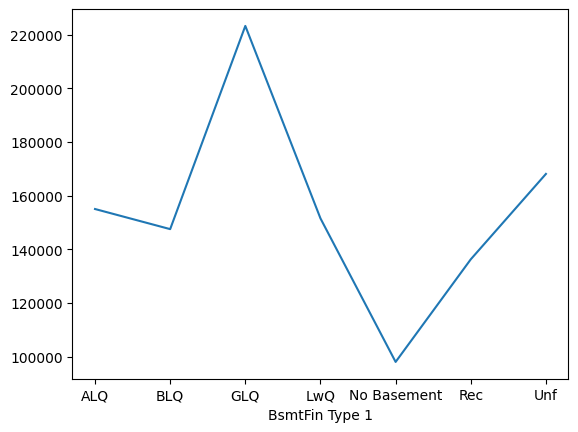

In [ ]:
df.groupby('BsmtFin Type 1')['SalePrice'].median().plot()

<Axes: >

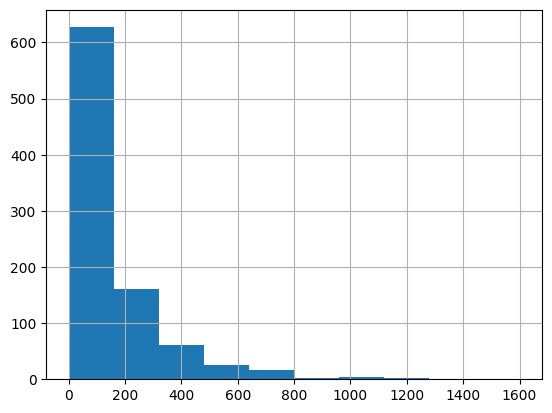

In [ ]:
df['Mas Vnr Area'].hist()

In [ ]:
df['Mas Vnr Area'].max()

1600.0

In [ ]:
df[['Mas Vnr Type','Mas Vnr Area']]

,Mas Vnr Type,Mas Vnr Area
0,no mas vnr,0.0
1,no mas vnr,0.0
2,no mas vnr,0.0
3,no mas vnr,0.0
4,no mas vnr,0.0
5,no mas vnr,0.0
6,no mas vnr,0.0
7,BrkFace,194.0
8,no mas vnr,0.0
9,no mas vnr,0.0
